# Imports

In [1]:
%pip install imbalanced-learn river

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

from sklearn.preprocessing import PowerTransformer, MinMaxScaler
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.neighbors import KNeighborsClassifier, LocalOutlierFactor
from scipy.stats import skew
from sklearn.decomposition import PCA
from sklearn.manifold import Isomap, LocallyLinearEmbedding, MDS
from imblearn.over_sampling import SMOTE, ADASYN

from sklearn.ensemble import ExtraTreesClassifier, HistGradientBoostingClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import ConfusionMatrixDisplay
import random

from imblearn.under_sampling import RandomUnderSampler

# Fetch

In [3]:
def process_cell(data):
    if '\n' in data:
        data = data.replace('\n', '')
    return float(data)

def read_from_files(path, file_list):
    y=[]
    X=[]
    for file in file_list:
        with open(path+'/'+file) as f:
            read_lines = f.readlines()
            for i in range(len(read_lines)):
                line = list(map(process_cell, read_lines[i].split(',')))
                X.append(line[1:])
                y.append(int(line[0]))
            f.close()
    return X,y
    
def get_decade_year(years, get_counts=False):
    year_enc = {}
    res_year = []
    res_dec = []
    counts = {dec:0 for dec in range(2,12)}
    year_enc={i: i if i>1 else i+10 for i in range(0,10)}
    for y in years:
        dec_year = y % 100
        decade = dec_year // 10
        year = dec_year % 10
        if get_counts:
            counts[year_enc[decade]]+=1
        res_dec.append(year_enc[decade])
        res_year.append(year)
    return (res_dec,res_year,counts) if get_counts else (res_dec,res_year)

In [4]:
files = list([f'data_{i}.txt' for i in range(1,6)])
path = './data'
X, y = read_from_files(path, files)

In [5]:
train_len = 463715
X_train, y_train = np.array(X[:train_len]), np.array(y[:train_len])
X_test, y_test = np.array(X[train_len:]), np.array(y[train_len:])

In [6]:
y_train_decade, y_train_year, counts = get_decade_year(y_train,get_counts=True)
y_test_decade, y_test_year = get_decade_year(y_test)

In [7]:
y_train = y_train % 100
y_test = y_test % 100

In [8]:
counts

{2: 204,
 3: 239,
 4: 295,
 5: 2827,
 6: 10573,
 7: 22349,
 8: 37613,
 9: 112133,
 10: 269118,
 11: 8364}

In [9]:
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
y_valid_decade = []
y_valid_year = []
y_valid = []
X_valid = []
for _, valid_index in sss.split(X_test, y_test_decade):
    for i in valid_index:
        y_valid_decade.append(y_test_decade[i])
        y_valid_year.append(y_test_year[i])
        y_valid.append(y_test[i])
        X_valid.append(X_test[i])
    y_test_decade = np.delete(y_test_decade,valid_index)
    y_test_year = np.delete(y_test_year,valid_index)
    X_test = np.delete(X_test, valid_index, axis=0)

# Analysis

## Analiza distribucije parametara

In [10]:
def plot_hist(data, axes, i, j, bins, color,title = None):
    m = np.mean(data)
    v = np.var(data)
    sns.histplot(data = data, bins = bins, ax = axes[i,j], color=color, legend=False)
    axes[i,j].axvline(m, color='red', linestyle='dashed', linewidth=2, label=f'Mean: {m:.2f}')
    axes[i,j].axvline(m - np.sqrt(v), color='green', linestyle='dashed', linewidth=2, label=f'-1 SD')
    axes[i,j].axvline(m + np.sqrt(v), color='green', linestyle='dashed', linewidth=2, label=f'+1 SD')

    if not title is None:
        axes[i,j].set_title(title)

def plot_scatter(X, y, axes, i, j, color, title = None):
    sns.scatterplot(x = X, y = y, ax = axes[i,j], color = color, legend = False, alpha=0.2)
    if not title is None:
        axes[i,j].set_title(title)

def plot_attribute_distribution(data):
    X_t = np.transpose(data)
    
    w = int(len(X_t)**0.5)
    h = len(X_t)//w
    if len(X_t)%w !=0:
        h+=1
    _, axes = plt.subplots(h, w, figsize = (30,30))
    for i in range(h):
        for j in range(w):
            ind = i*w + j
            plot_hist(X_t[ind], axes, i, j, 50, 'steelblue')
    plt.tight_layout()
    plt.show()


def plot_target_dependance(data, target, start, end):
    """Iscrtava zavisnost target atributa od svakog atributa u data"""
    X_t = np.transpose(data)
    size = min(end-start, len(X_t))
    w = int(size**0.5)
    h = size//w
    print(f"{w} x {h}")
    if size%w !=0:
        h+=1
    _, axes = plt.subplots(h, w, figsize = (10,10))
    for i in range(h):
        for j in range(w):
            ind = start + i * w + j
            if ind < start or ind>=end:
                continue
            plot_scatter(X_t[ind], target, axes, i, j, 'steelblue')
    plt.tight_layout()
    plt.show()


<div class="alert alert-block alert-danger">
<b>Veliki procenat atributa ne prati normalnu raspodelu</b>
</div>

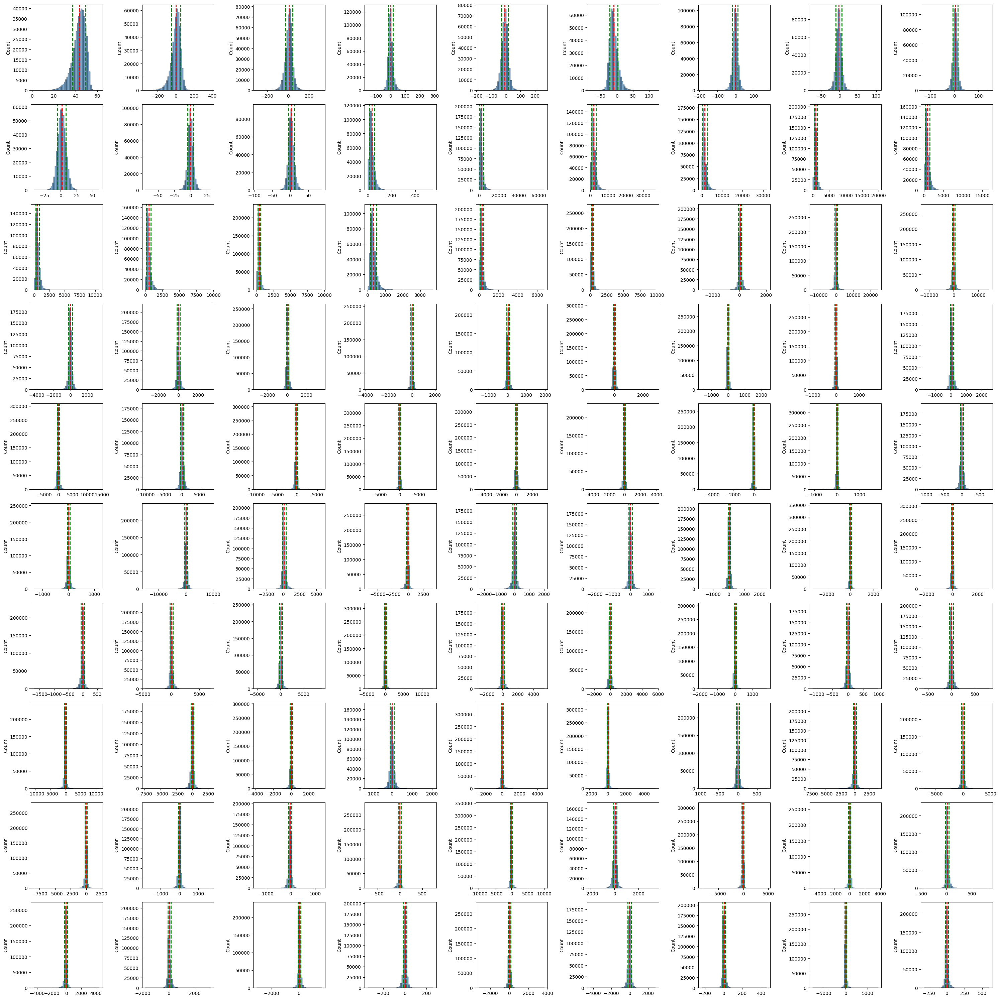

In [11]:
plot_attribute_distribution(X_train)

## Analiza zavisnosti ciljne labele (decenije) od atributa

<div class="alert alert-block alert-danger">
<b>Usled razlika u broju pesama tesko je zakljuciti da li je razlika u zavisnostima decenije izdavanja i atributa pesme usled nedovoljne kolicine podataka ili zbog obrasca medju podacima </b>
</div>

2 x 2


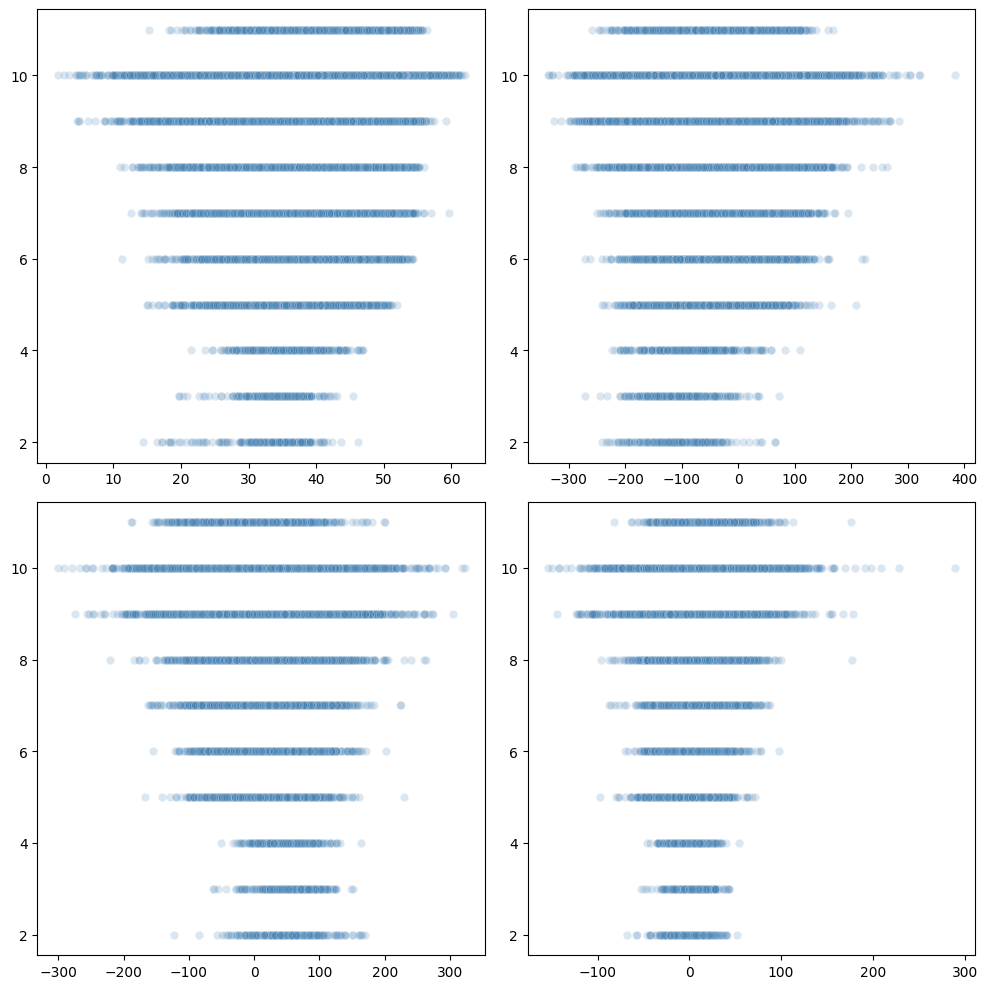

2 x 2


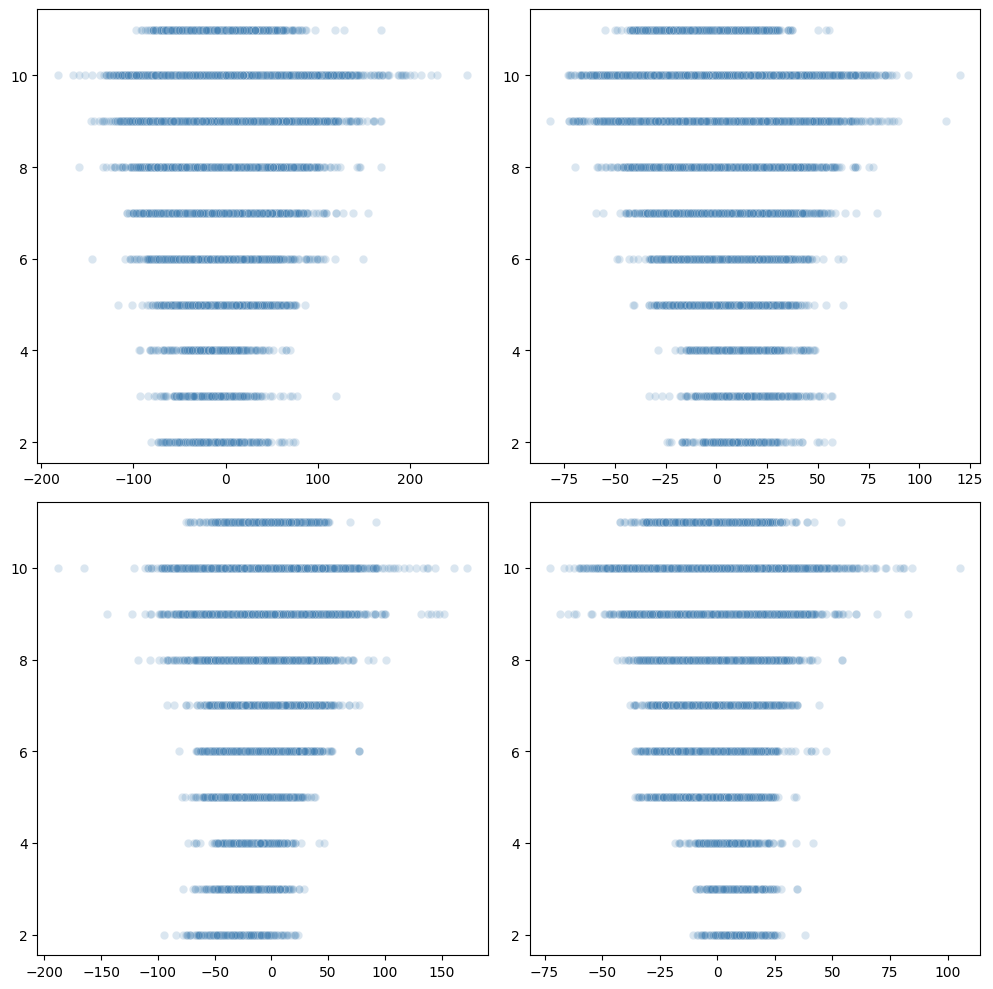

2 x 2


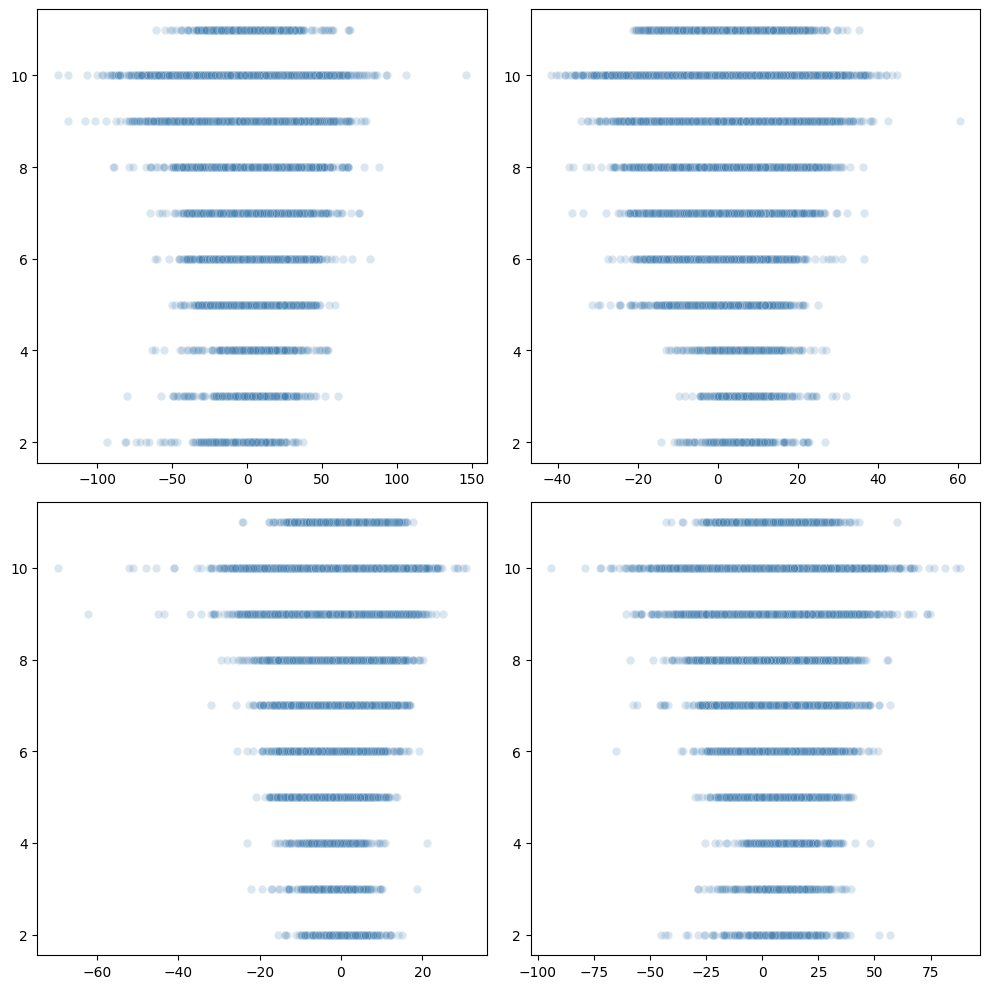

2 x 2


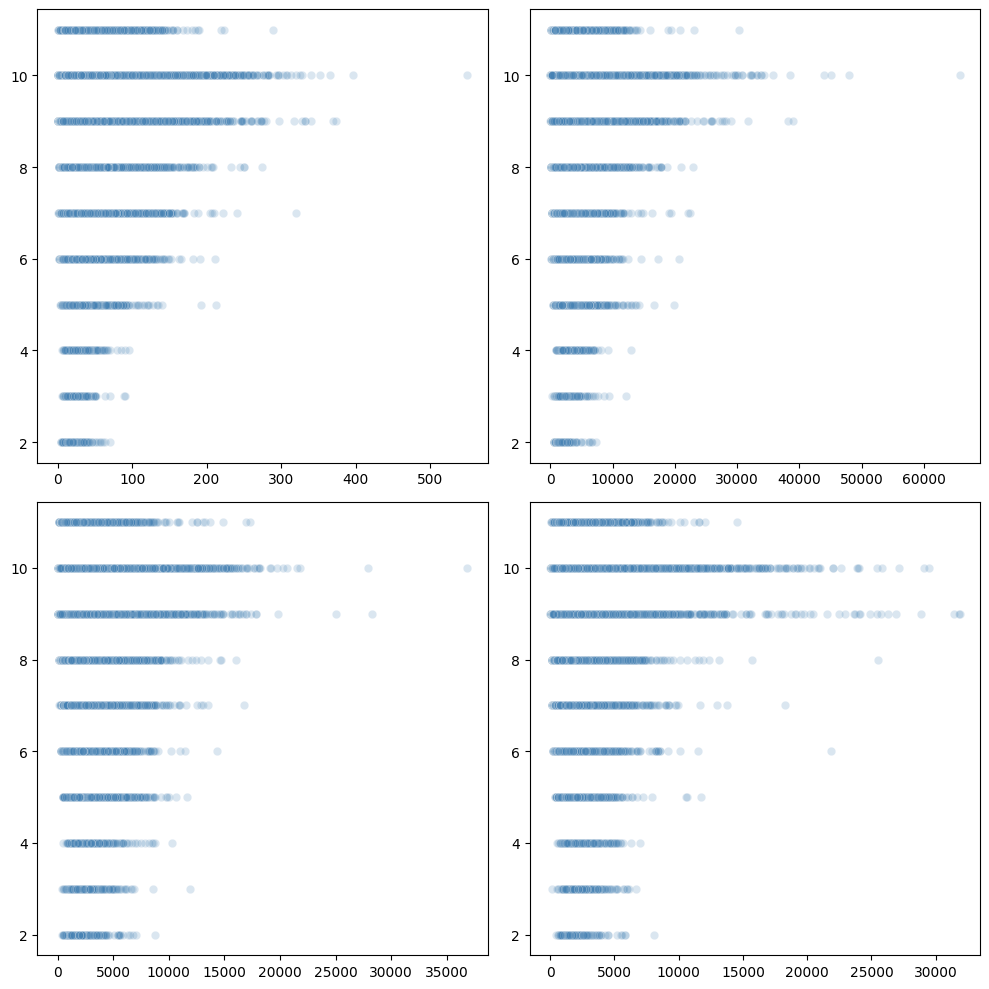

2 x 2


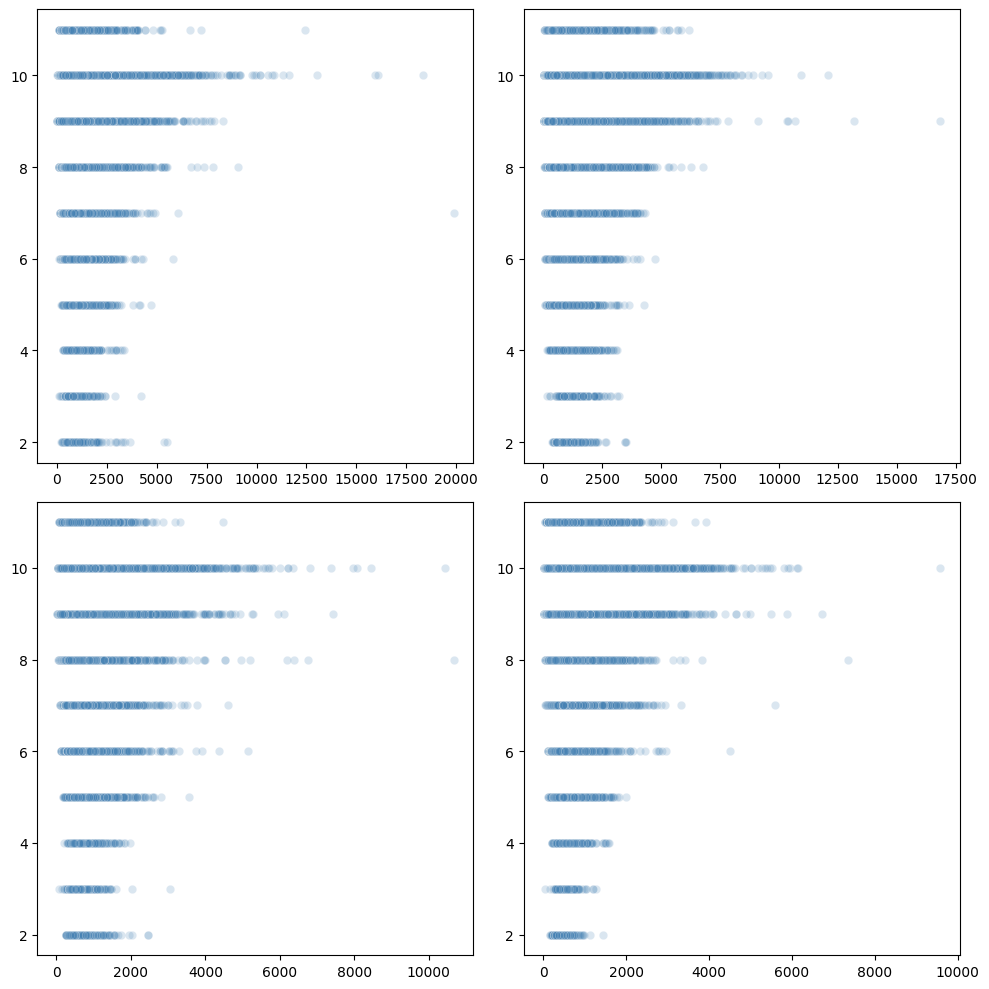

2 x 2


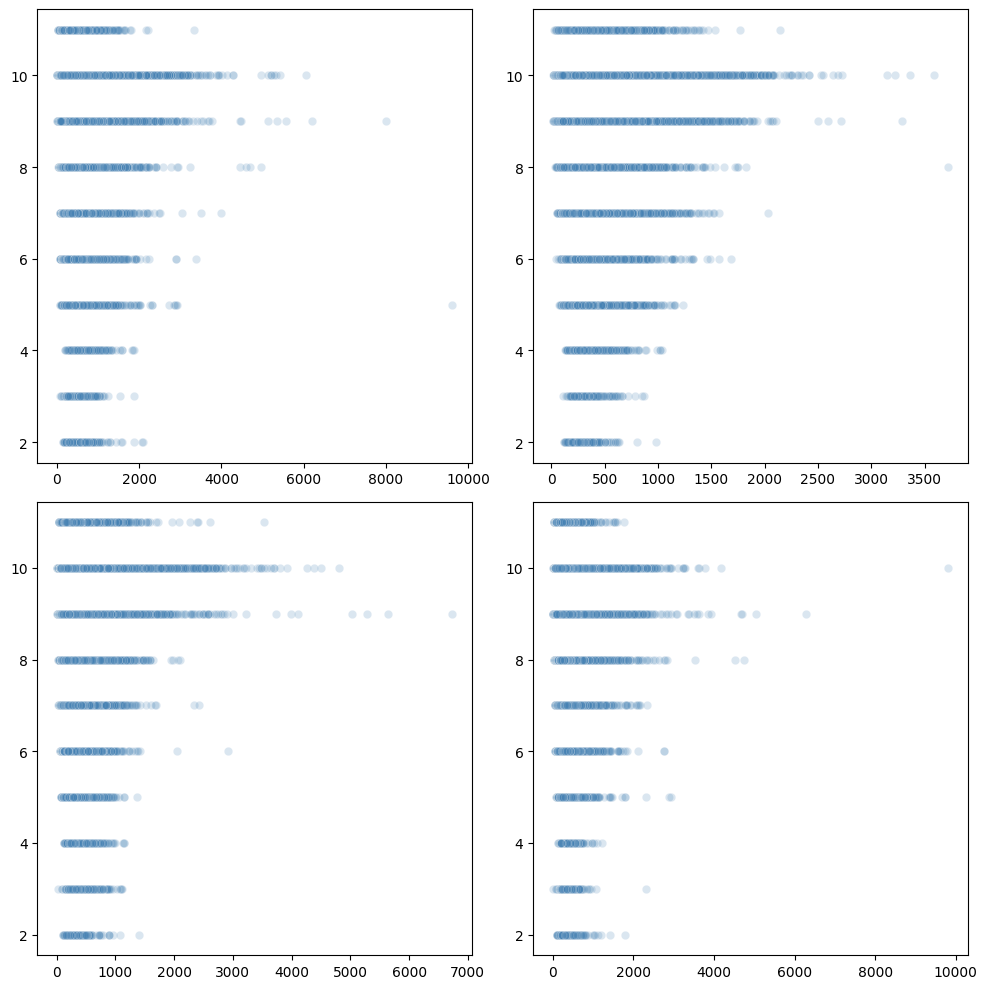

2 x 2


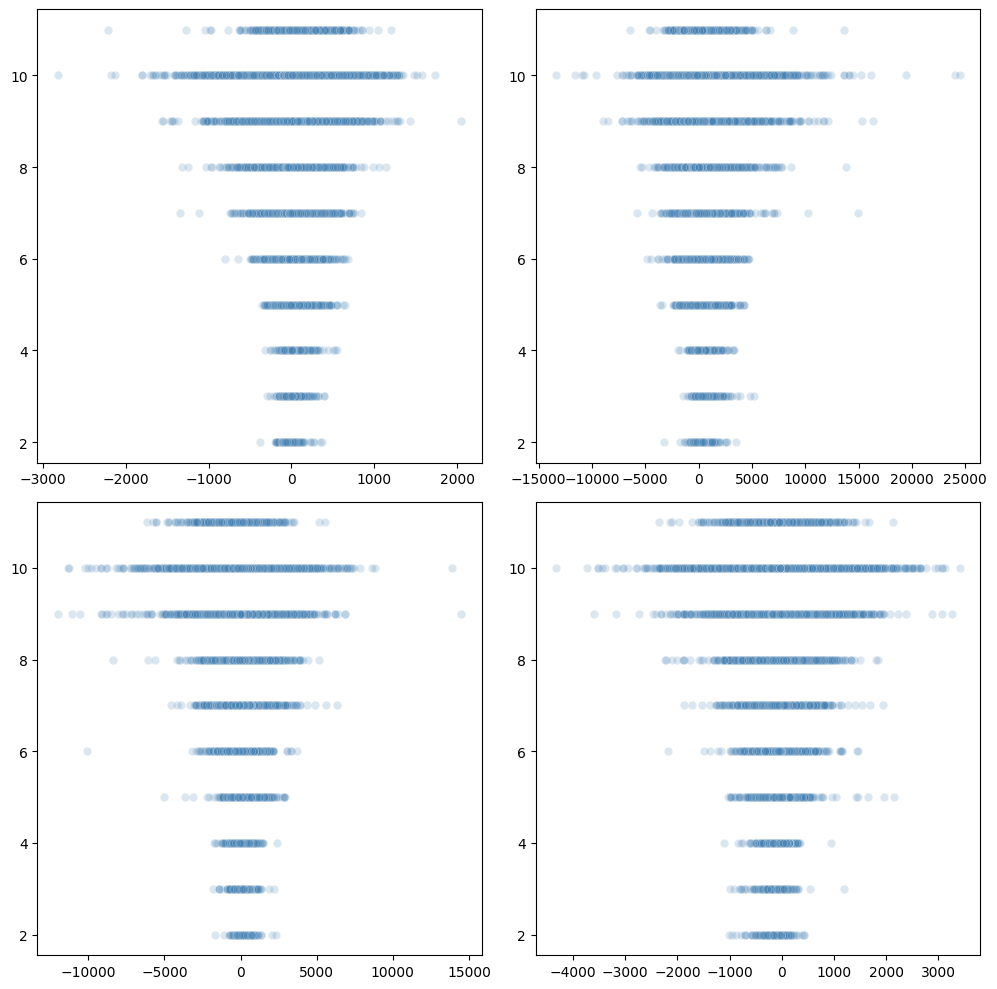

2 x 2


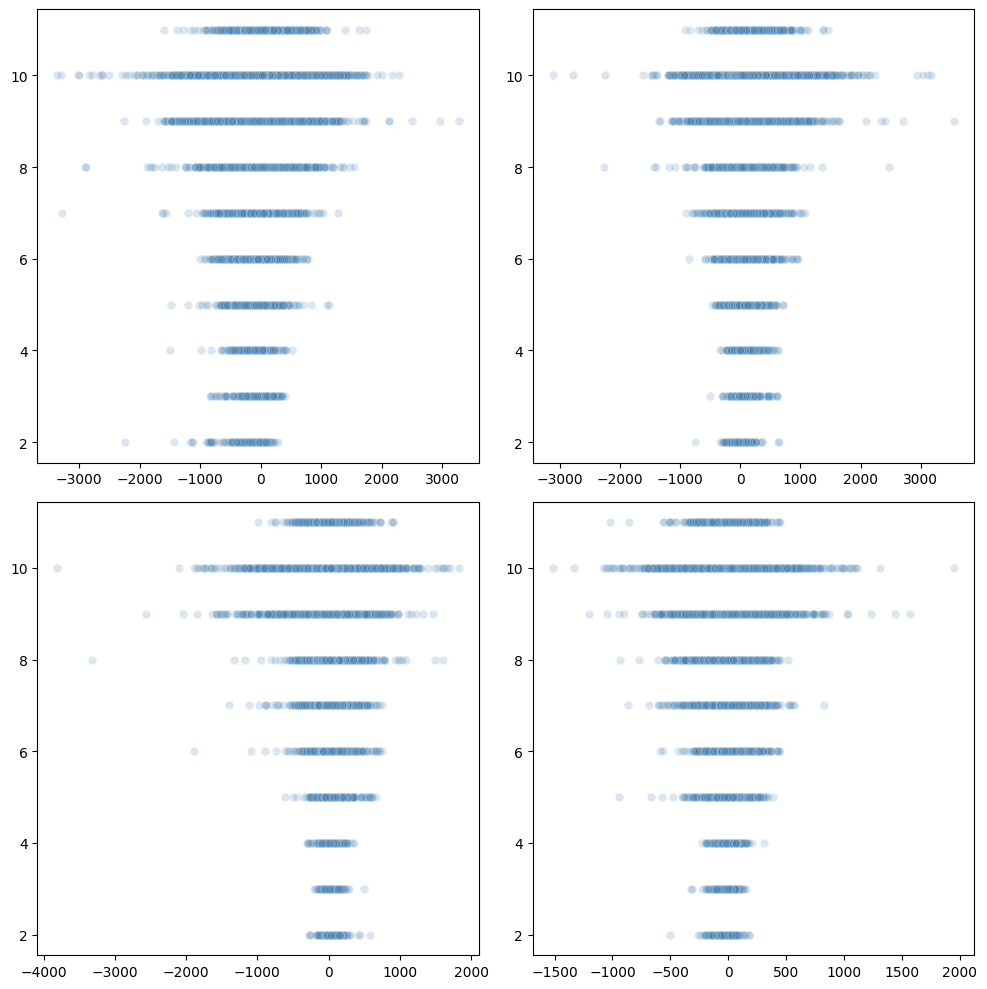

2 x 2


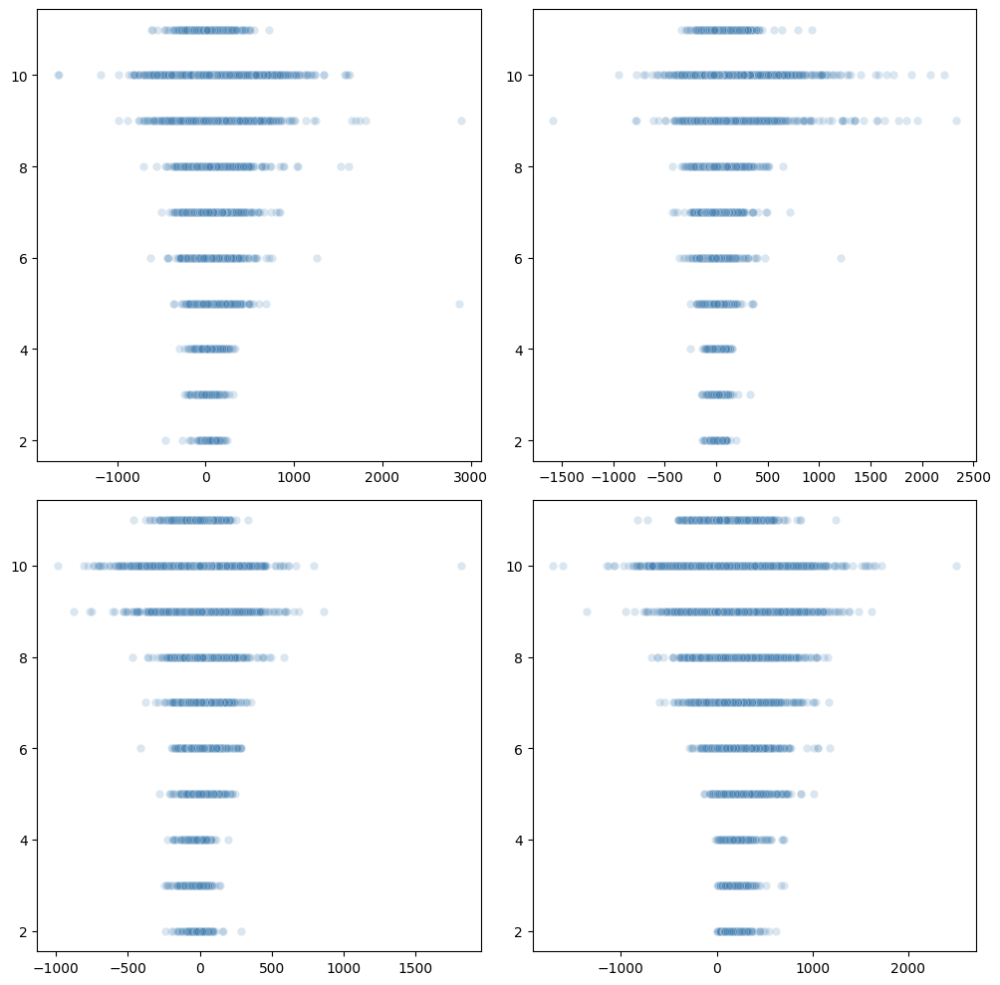

2 x 2


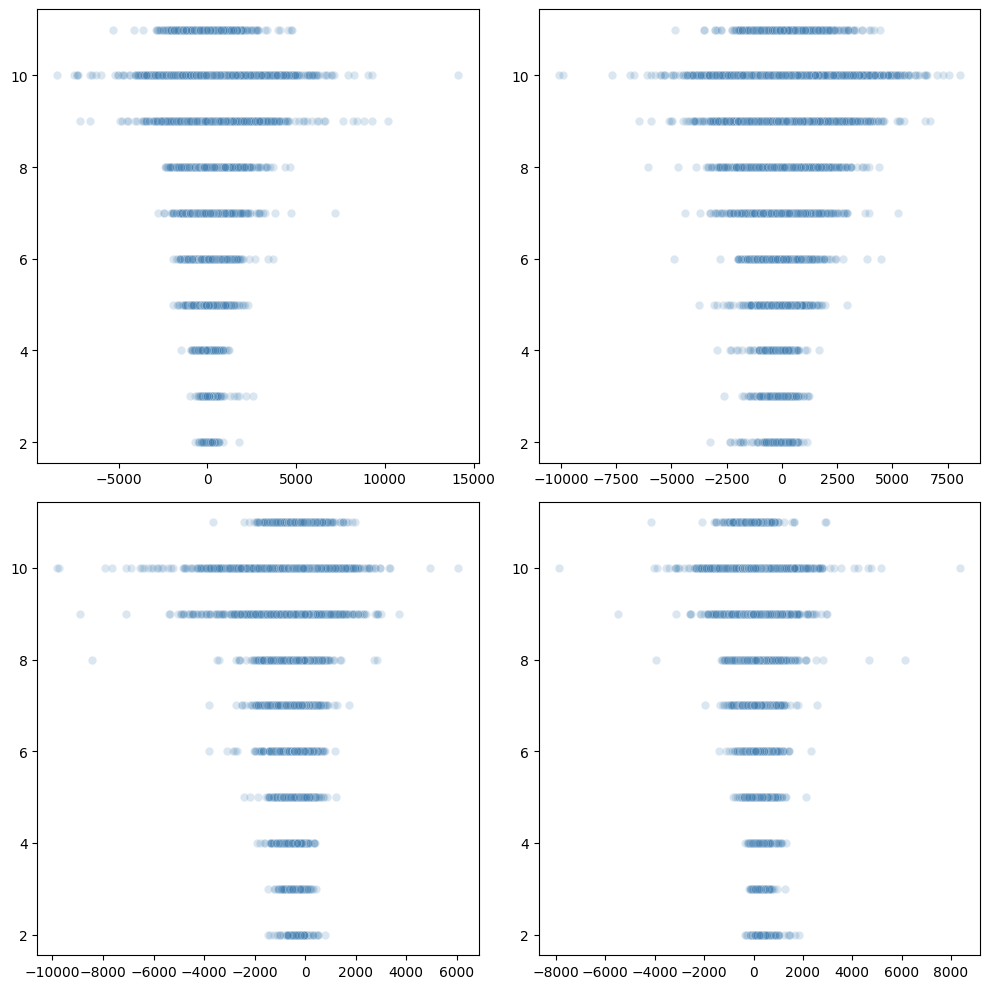

2 x 2


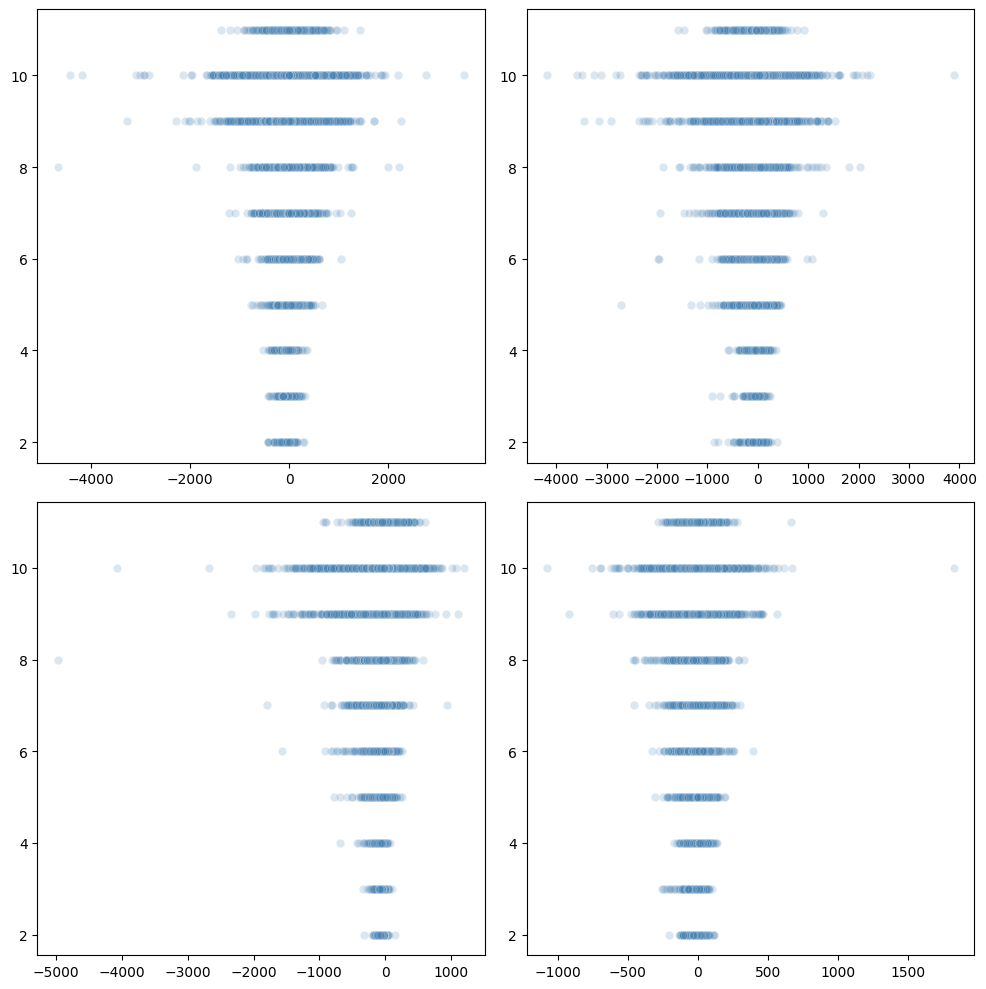

2 x 2


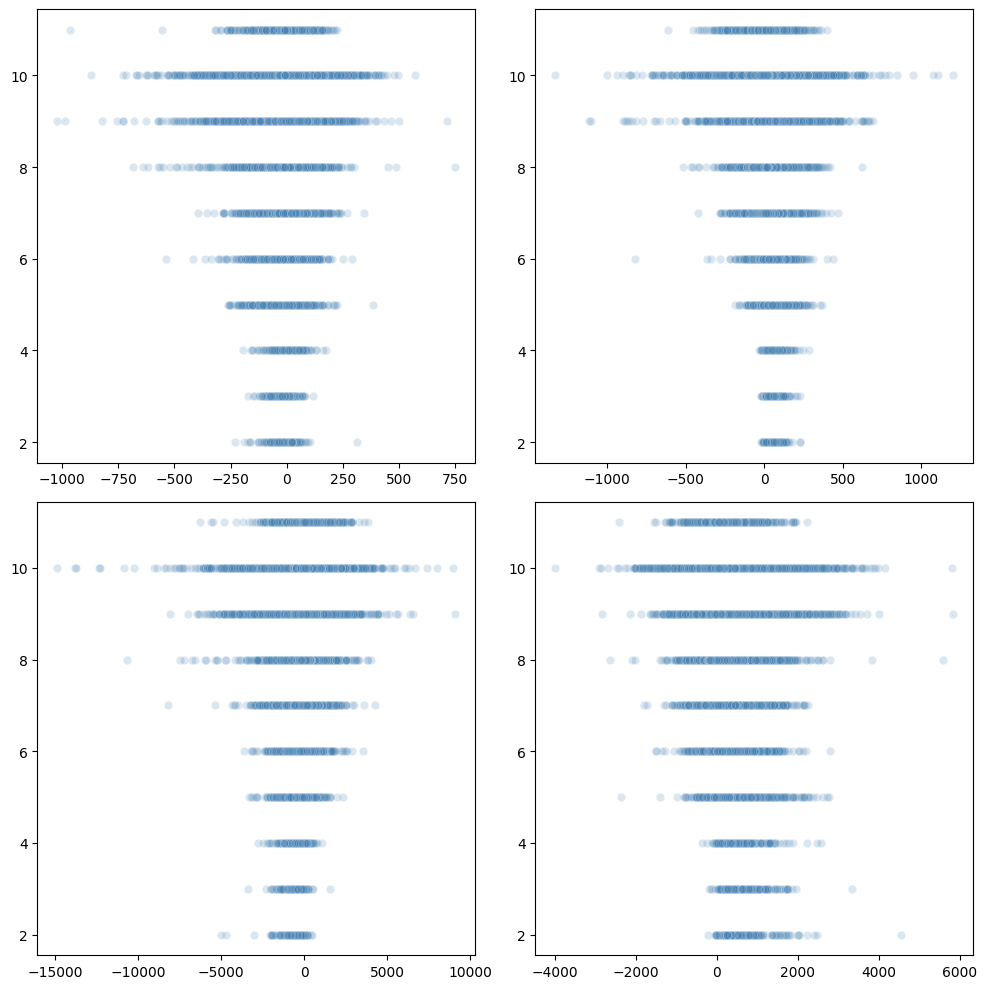

2 x 2


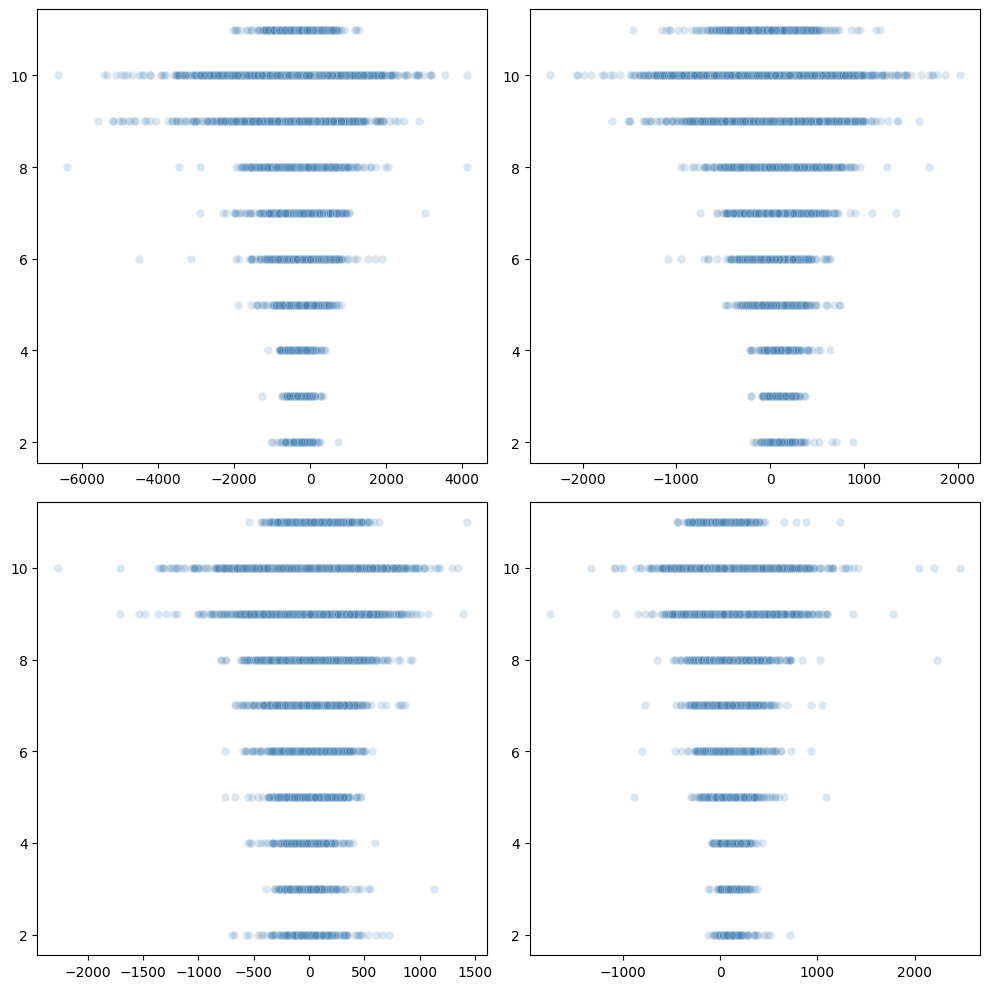

2 x 2


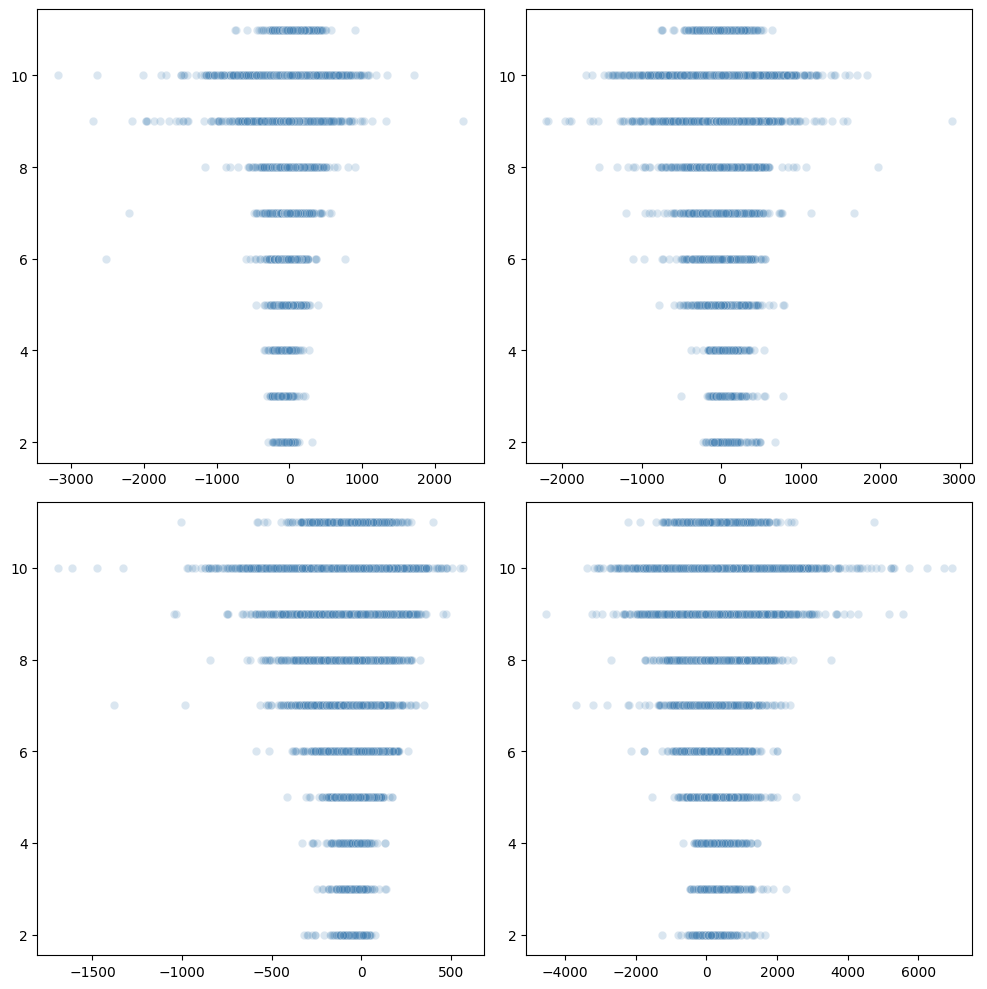

2 x 2


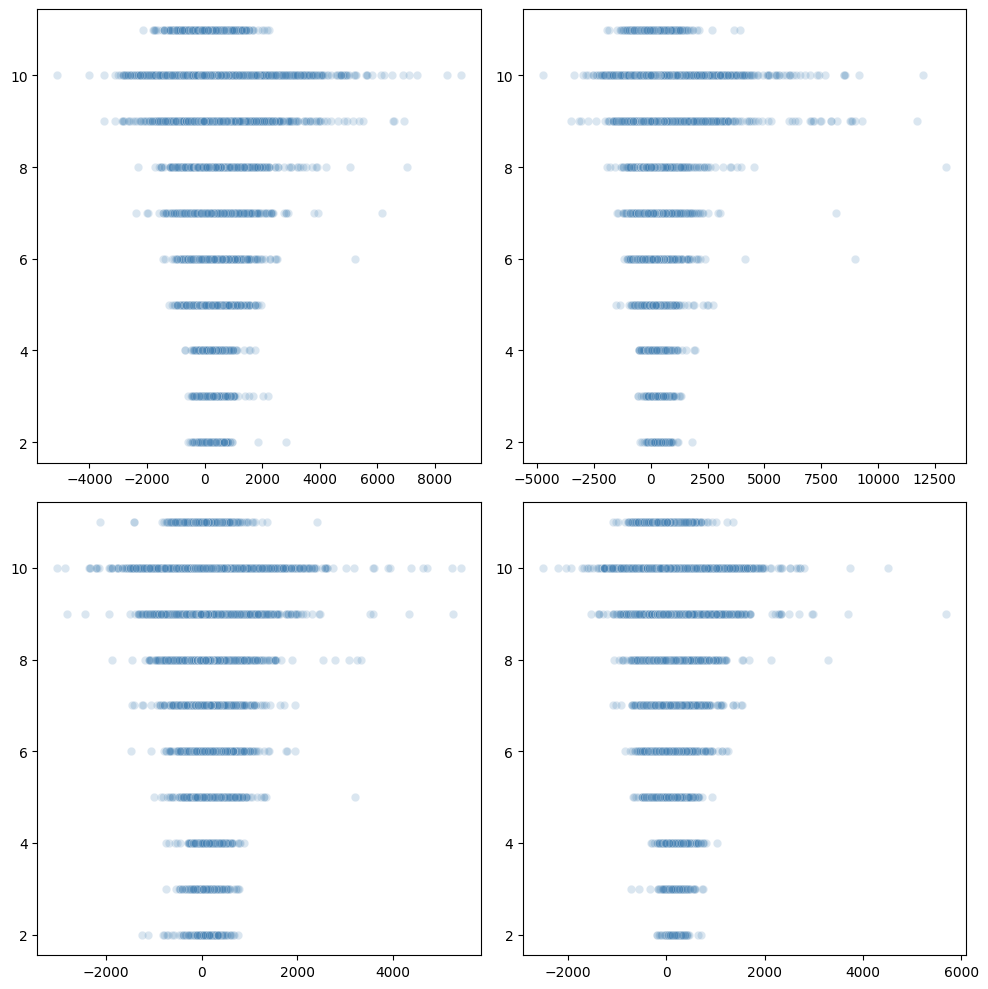

2 x 2


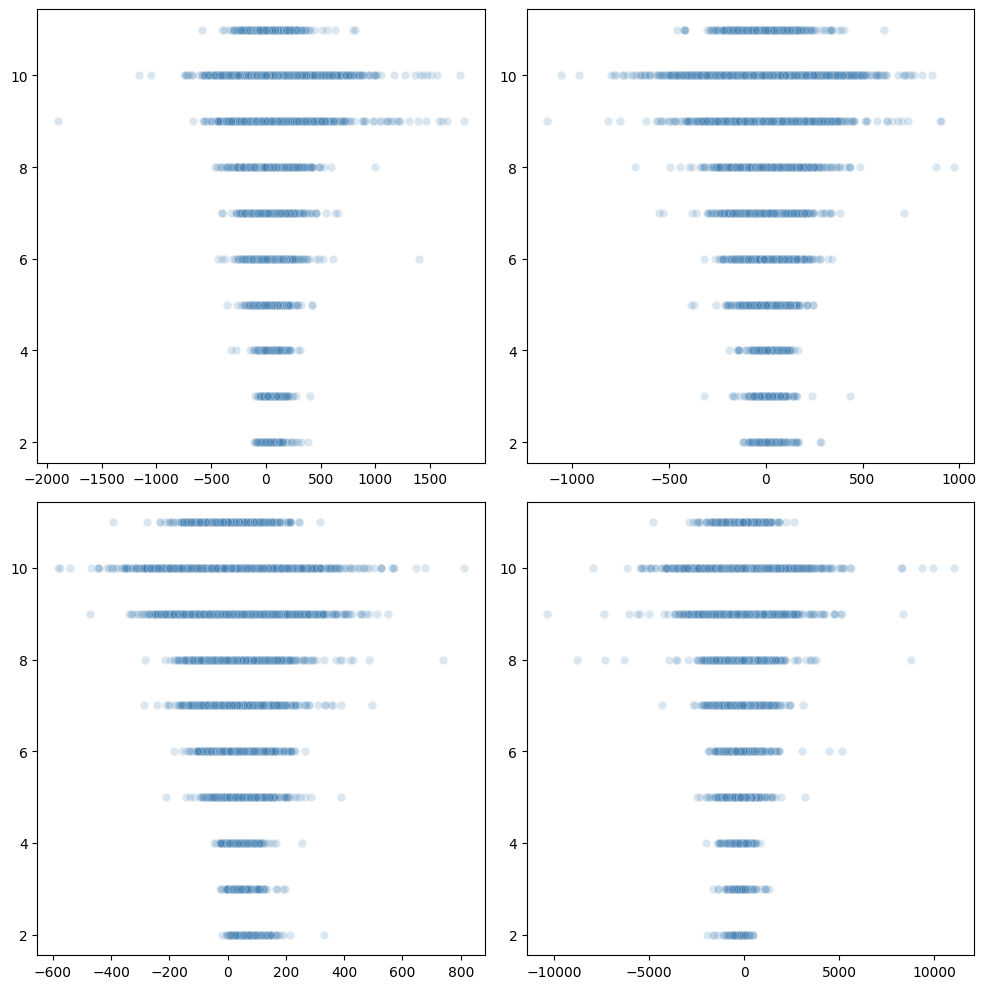

2 x 2


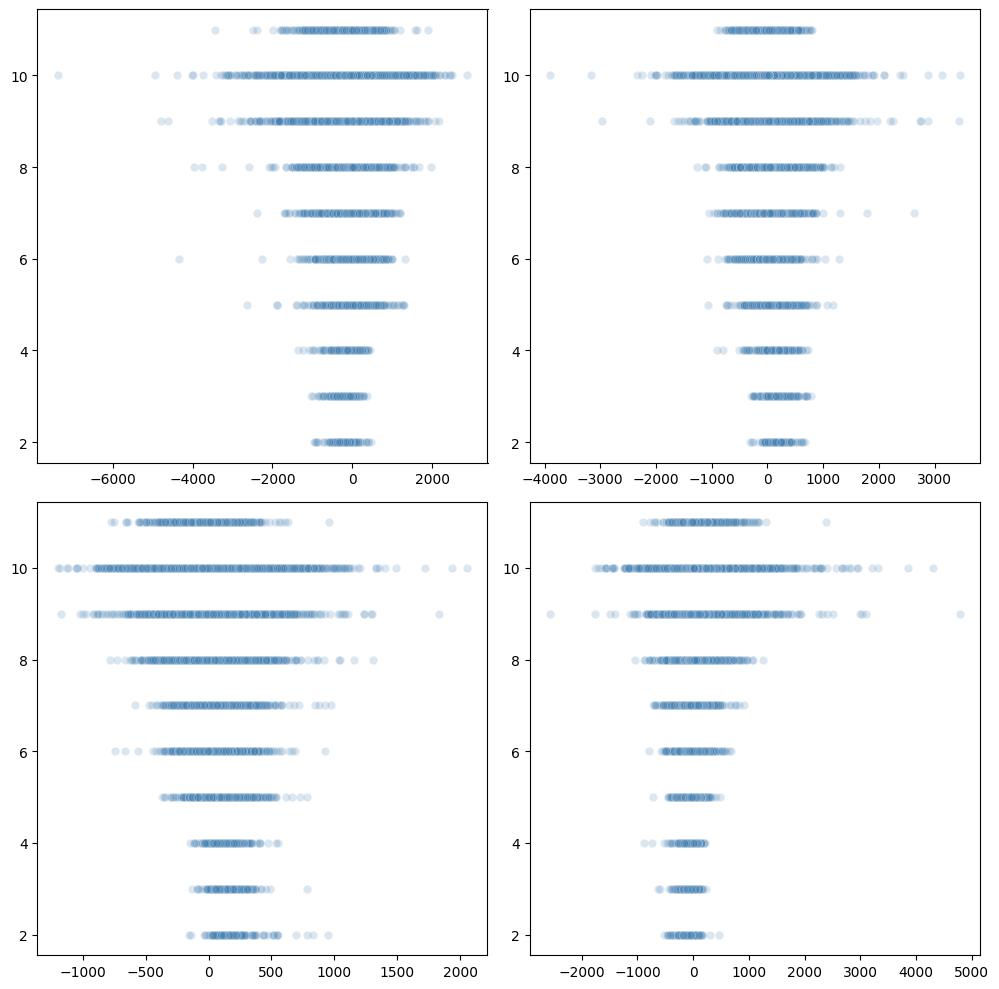

2 x 2


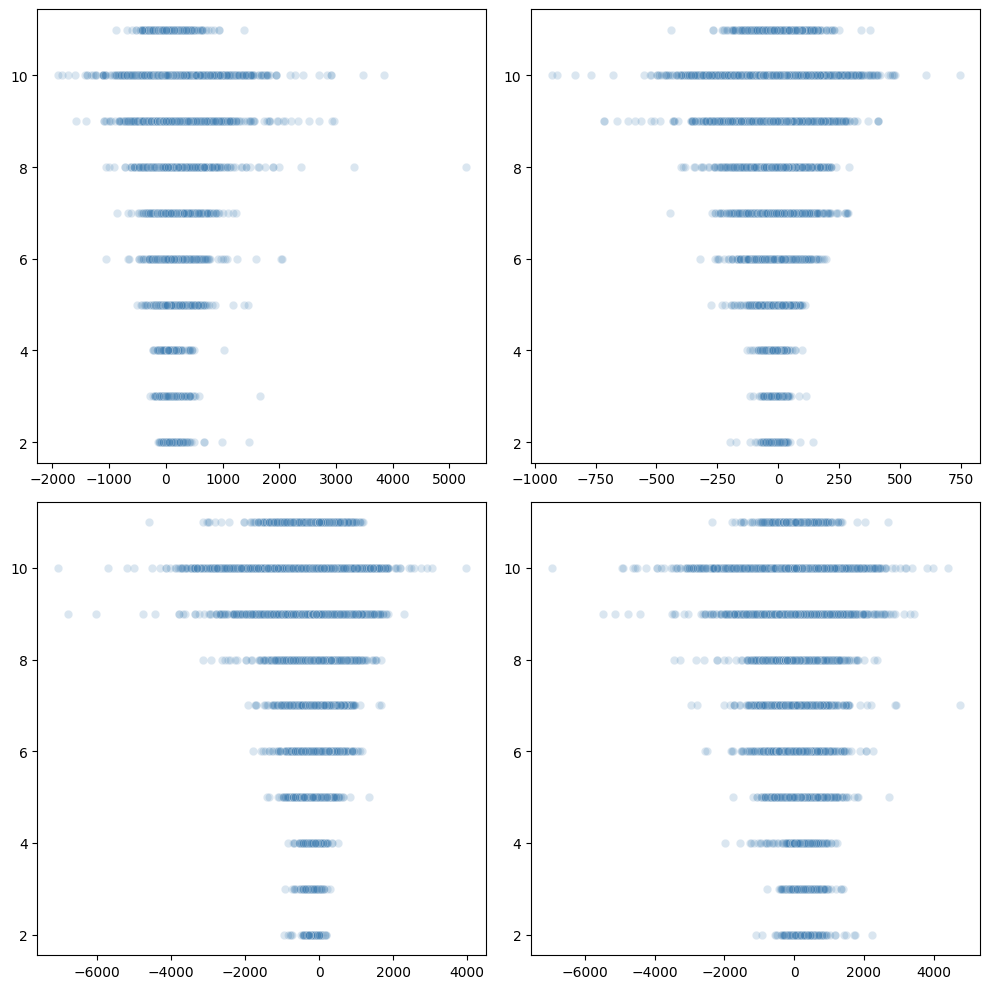

2 x 2


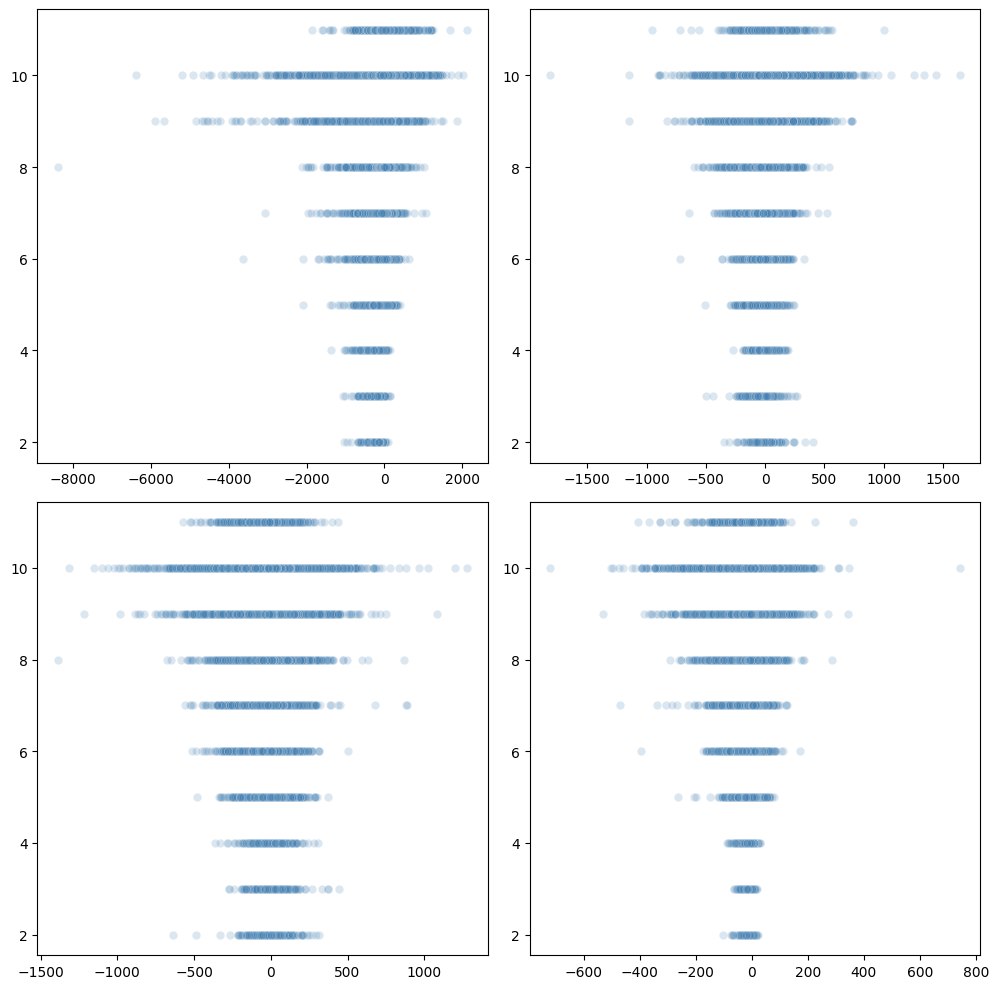

2 x 2


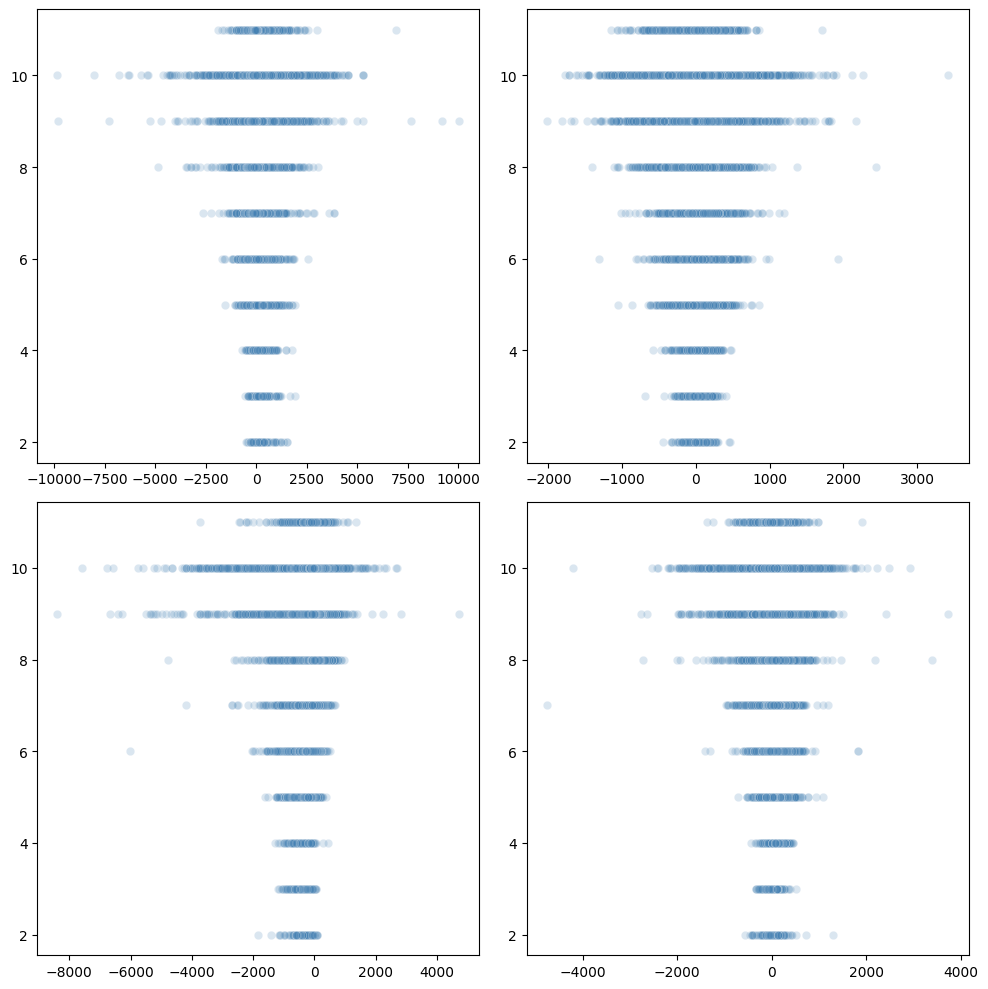

2 x 2


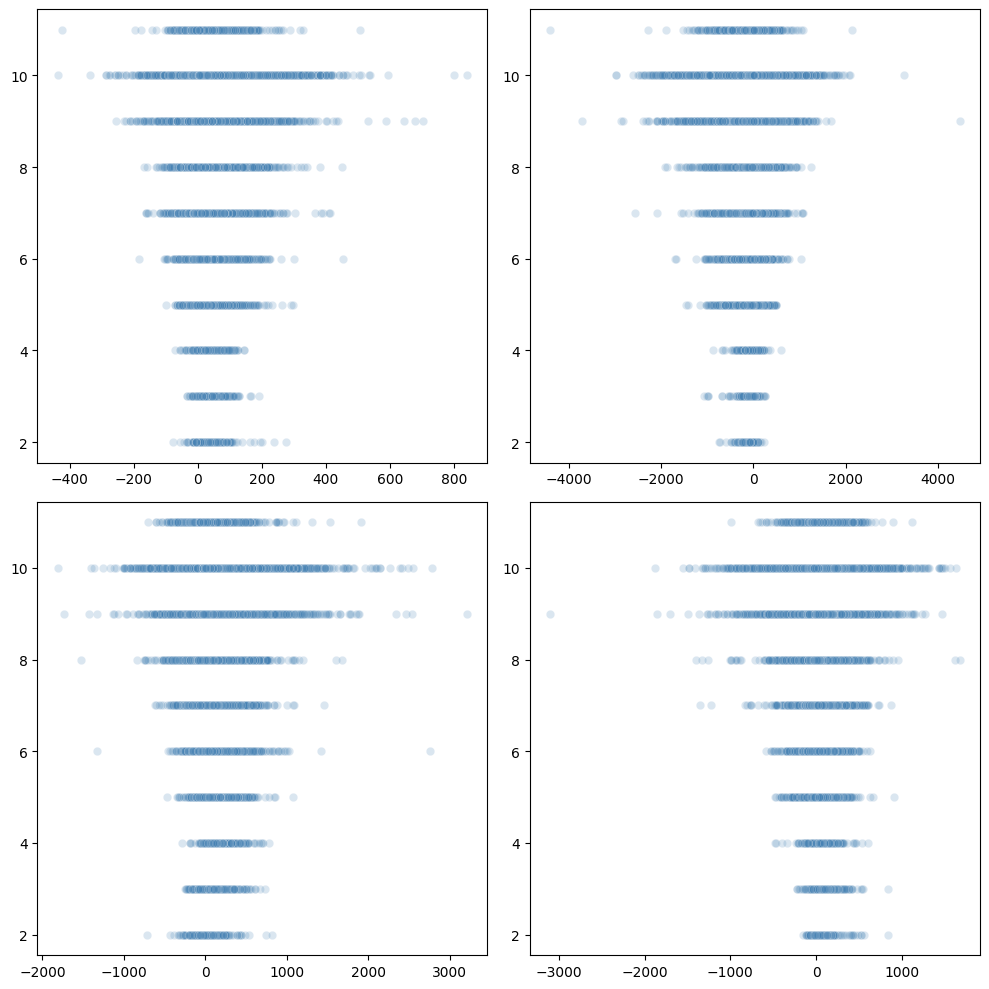

2 x 2


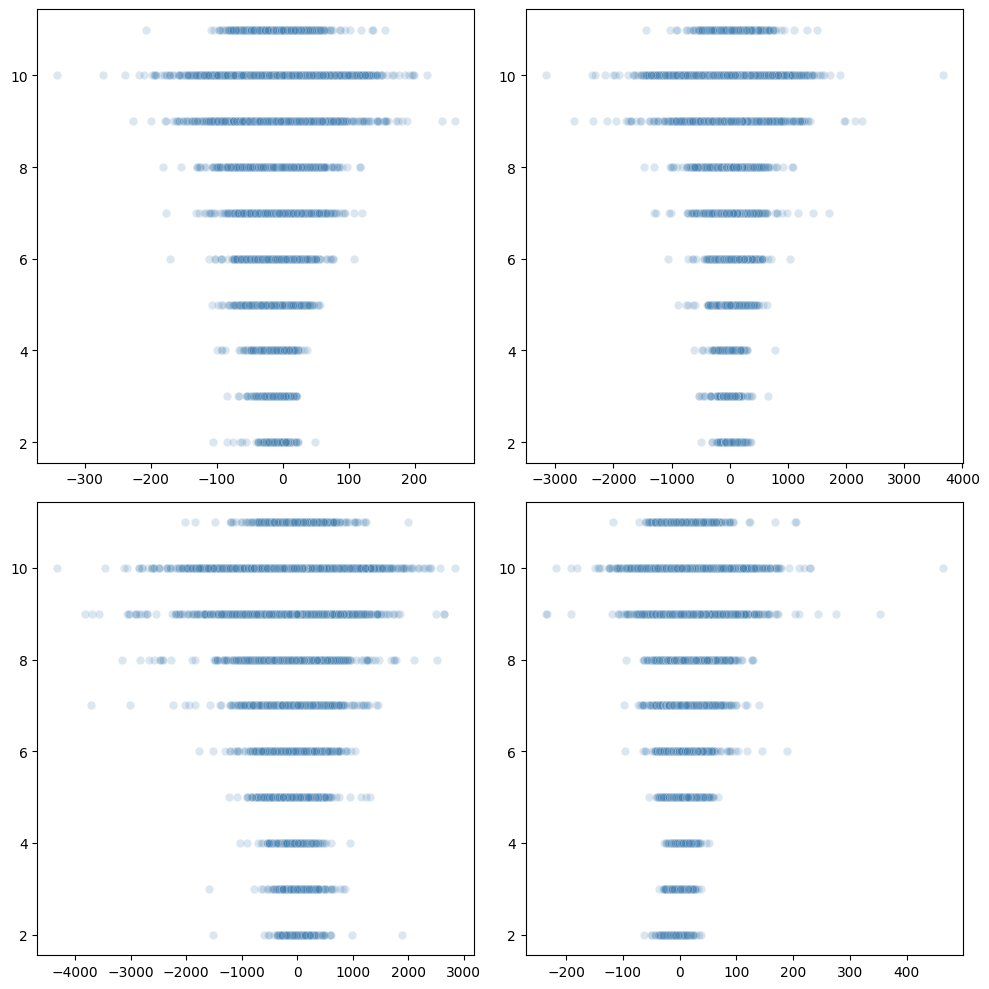

2 x 2
index 90 is out of bounds for axis 0 with size 90


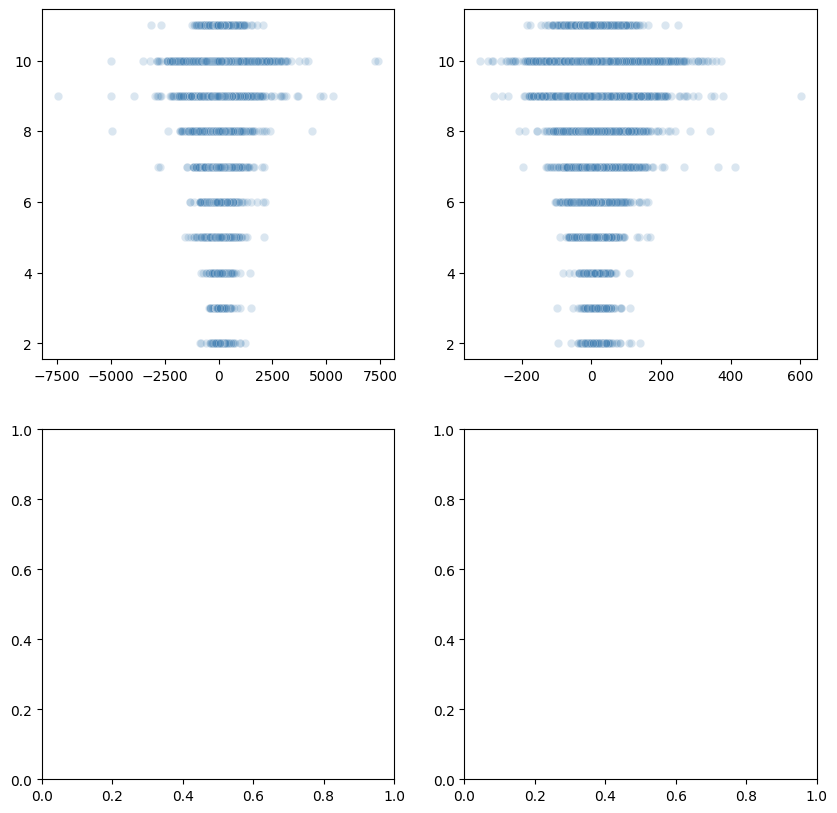

In [12]:
i = 0
while i<len(X_train[0]):
    try:
        plot_target_dependance(X_train, y_train_decade, start=i, end=i+4)
    except Exception as e:
        print(e)
    i+=4

In [13]:
full = np.hstack((X_train, np.array(y_train_decade).reshape(len(y_train_decade),1)))
df = pd.DataFrame(full)
cov_mat = df.corr()
decade_correlation = np.corrcoef(x = full, rowvar = False)[len(cov_mat)-1]
decade_correlation = np.sort(decade_correlation)
decade_correlation

array([-0.18042258, -0.13590505, -0.11944865, -0.11918806, -0.09931716,
       -0.09665567, -0.09547652, -0.09373707, -0.09298747, -0.09136829,
       -0.08786782, -0.08580416, -0.08319419, -0.0704791 , -0.06518483,
       -0.06469726, -0.05706399, -0.05587715, -0.05524354, -0.05435365,
       -0.0541081 , -0.05194758, -0.05002002, -0.04952338, -0.04892696,
       -0.04529997, -0.0400741 , -0.03950961, -0.03729022, -0.03604388,
       -0.03526475, -0.03456497, -0.03223765, -0.02928834, -0.02489853,
       -0.02159967, -0.01887852, -0.01852712, -0.01244479, -0.00931662,
       -0.00574952, -0.00541227, -0.00516146, -0.00359592, -0.00344729,
       -0.00135571, -0.0013053 ,  0.0058498 ,  0.00645766,  0.00939317,
        0.01001003,  0.01085169,  0.01087274,  0.01152756,  0.01160451,
        0.0117925 ,  0.01332322,  0.01409401,  0.01502849,  0.01872973,
        0.02206816,  0.02222098,  0.02439219,  0.02470863,  0.02665893,
        0.02689753,  0.02810182,  0.02892002,  0.0291848 ,  0.02

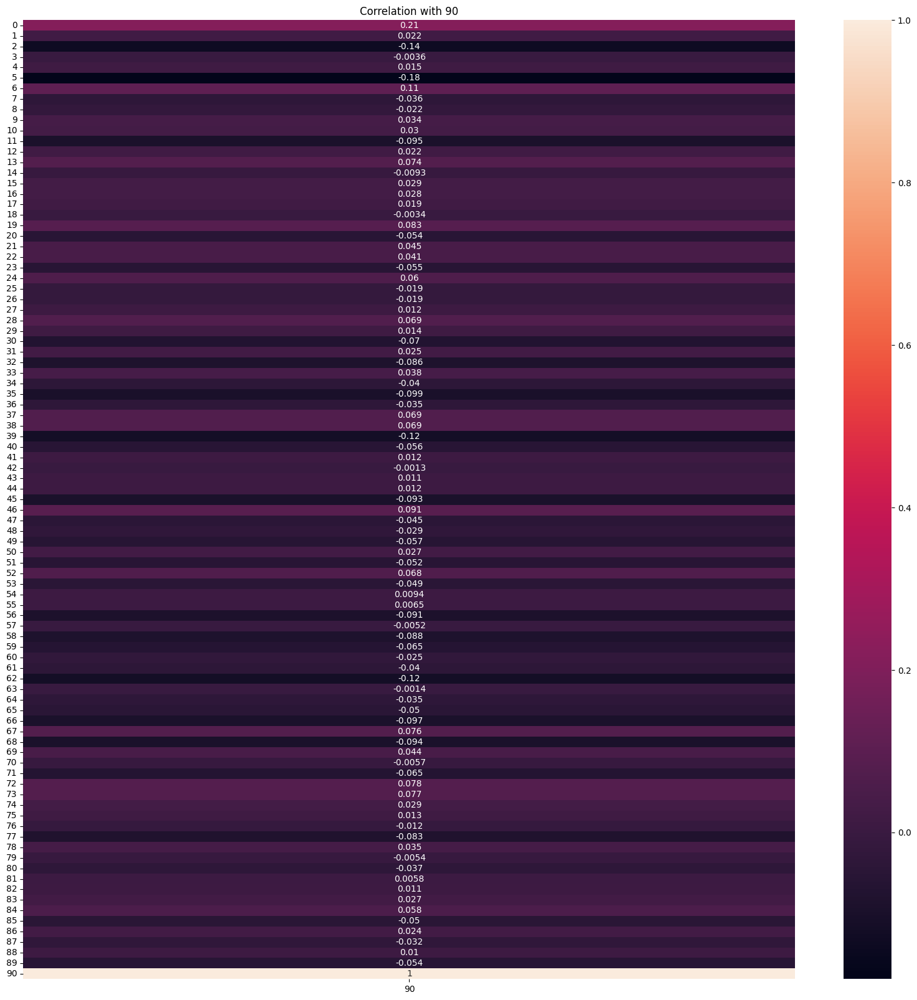

In [14]:
last_variable = cov_mat.columns[-1]
last_row_column = cov_mat[last_variable]
plt.figure(figsize=(20, 20))
sns.heatmap(last_row_column.to_frame(), annot=True)
plt.title(f"Correlation with {last_variable}")
plt.show()

## Broj pesama po decenijama

<div class="alert alert-block alert-info">
<b>Postoji velika razlika u broju pesama za razlicite decenije</b>
</div>

<BarContainer object of 10 artists>

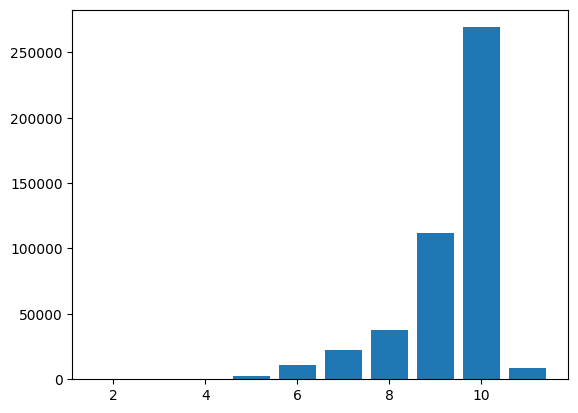

In [15]:
# Raspodela broja pesama po decenijama
plt.bar(list(counts.keys()), list(counts.values()), align='center')

# Feature Engineering

## Feature normalization

In [16]:
def normalize_distributions(X: np.array, eps: float, transform_method:str = 'yeo-johnson'):
    """Transforms each column in X such that it more closesly follows the normal distribution \n
        X - data to transform\n
        eps - skew threshold - if the absolute value of the attribute distribution skewness is greater than eps, transform the attribute\n
        transform - transform function to apply to the attribute\n
        \n
        Returns the applied transformations for each of the attributes
    """
    X_t = np.transpose(X.copy())
    applied_transforms = {i: [None] for i in range(len(X_t))}
    for i in range(len(X_t)):
        s = skew(X_t[i])
        if abs(s)>eps:
            transform = PowerTransformer(transform_method)
            X_t[i] = transform.fit_transform(X_t[i].reshape(-1,1)).reshape(1,-1)
            applied_transforms[i] = [transform]
    return (np.transpose(X_t),applied_transforms)

In [17]:
X_transformed, applied_transform_dict = normalize_distributions(X_train,0.1)

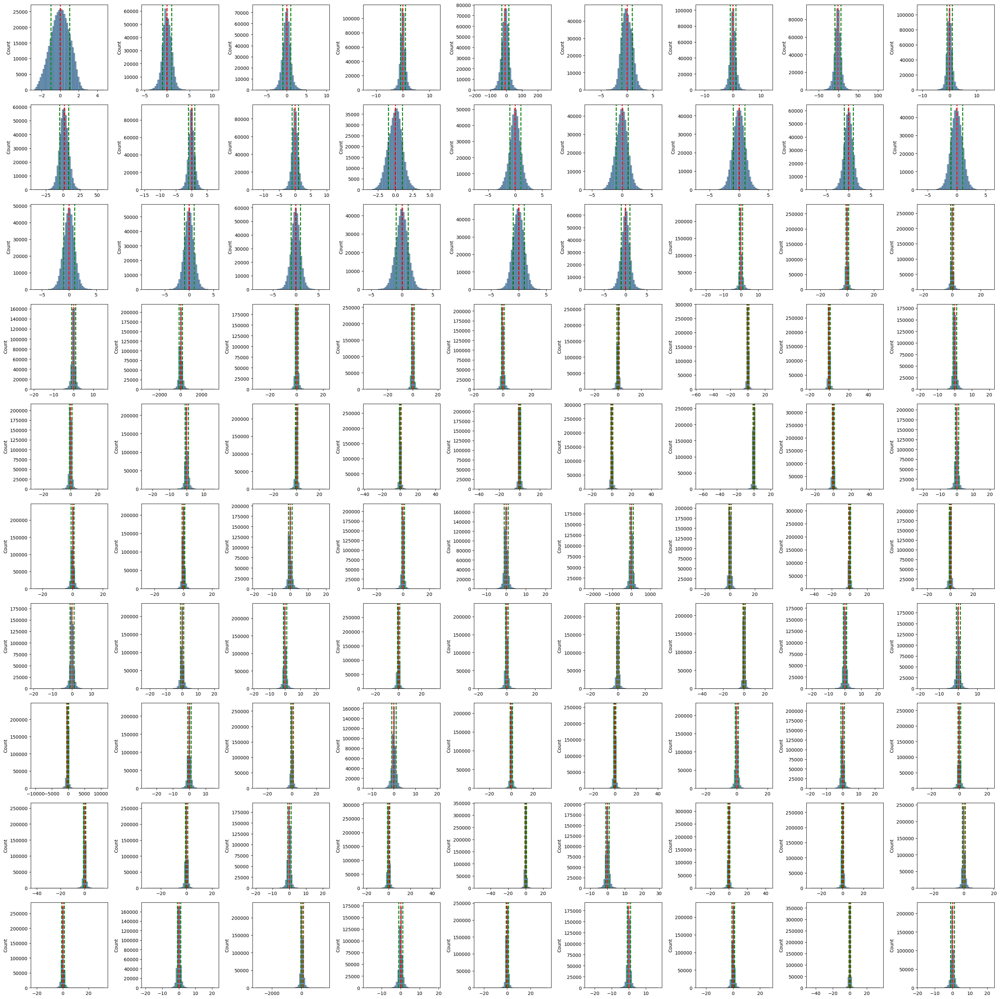

In [18]:
plot_attribute_distribution(X_transformed)

## Feature scaling

In [19]:
def scale_data(X: np.array, transforms_dict: dict):
    X_t = np.transpose(X.copy())
    for i in range(len(X_t)):
        scaler = MinMaxScaler()
        X_t[i] = scaler.fit_transform(X_t[i].reshape(-1,1)).reshape(1,-1)
        transforms_dict[i].append(scaler)
    return np.transpose(X_t)

In [20]:
X_transformed = scale_data(X_transformed, applied_transform_dict)

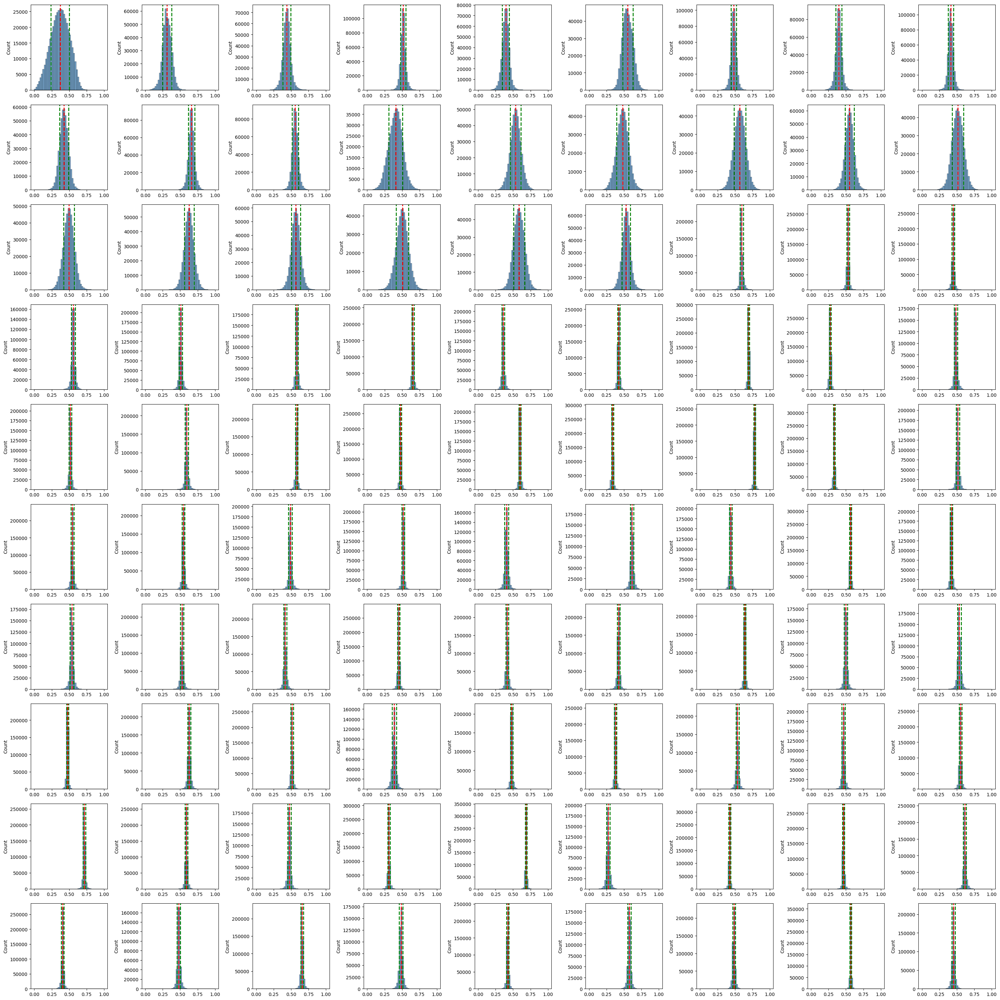

In [21]:
plot_attribute_distribution(X_transformed)

## Outlier Removal

### Isolation Forest

In [22]:
def plot_outliers_cols(data, col1, col2, outliers):
    color_map = {1: 'blue', -1: 'red'}
    colors = [color_map[i] for i in outliers]

    plt.scatter(data[col1], data[col2], c=colors, alpha=0.1)

    plt.xlabel(col1)
    plt.ylabel(col2)

    plt.show()

def plot_outliers(X, y, outliers):
    color_map = {1: 'blue', -1: 'red'}
    colors = [color_map[i] for i in outliers]

    plt.scatter(X, y, c=colors, alpha=0.1)

    plt.show()

In [23]:
isf = IsolationForest(n_estimators=1000, n_jobs=-1, contamination=0.1)
pred1 = isf.fit_predict(X_transformed)
c = (pred1<0).sum()
print("Outliers: ",c)

Outliers:  46372


In [24]:
ind = []
for i in range(len(pred1)):
    if pred1[i] == -1:
        ind.append(i)
outliers = X_transformed[ind]

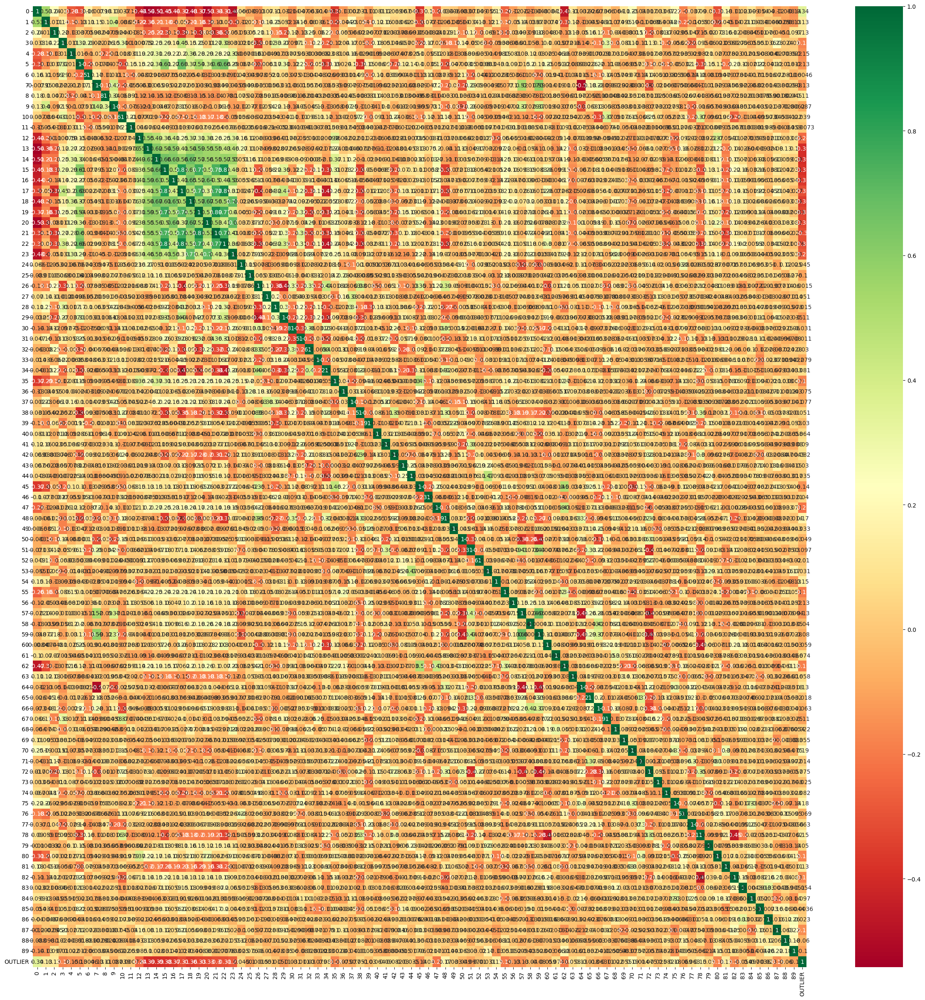

In [25]:
df = pd.DataFrame(X_transformed)
df['OUTLIER'] = pred1
plt.figure(figsize=(30,30))
g=sns.heatmap(df.corr(),annot=True,cmap="RdYlGn")

In [26]:
c = df.corr()
c = abs(c['OUTLIER']).sort_values(ascending=False).drop(['OUTLIER'])

In [27]:
most_affected_atts = list(c[:5].keys())

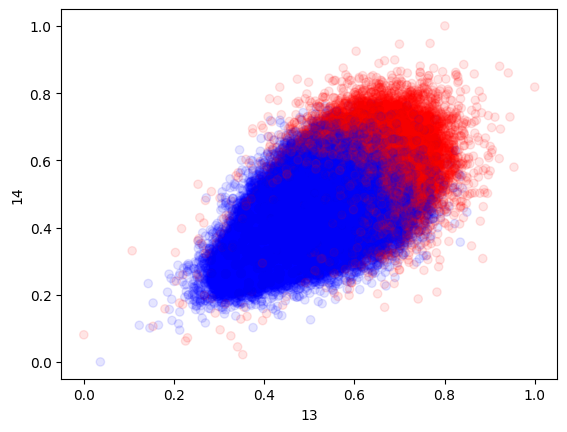

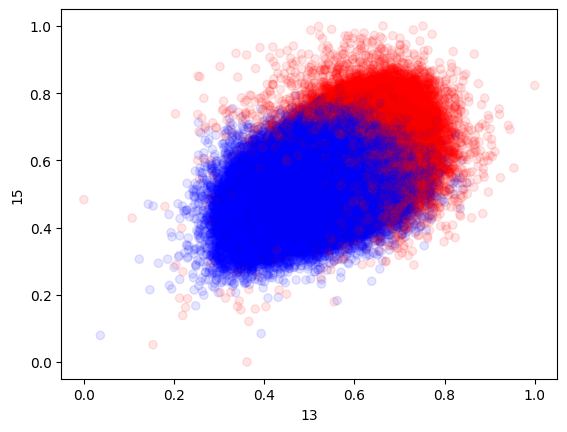

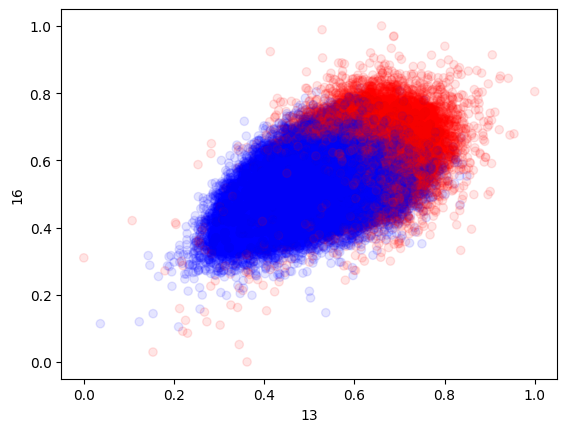

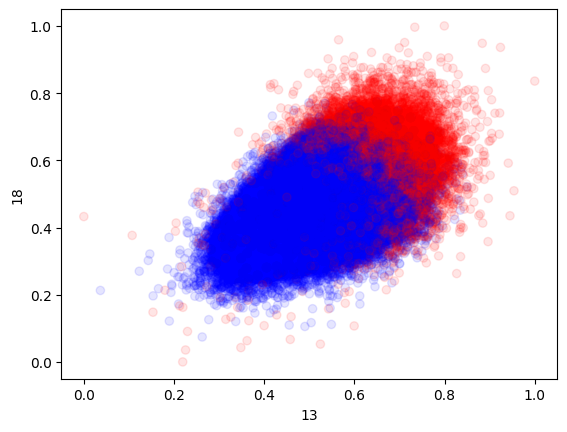

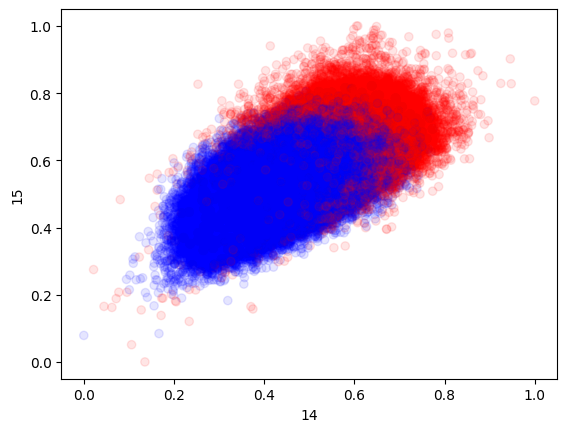

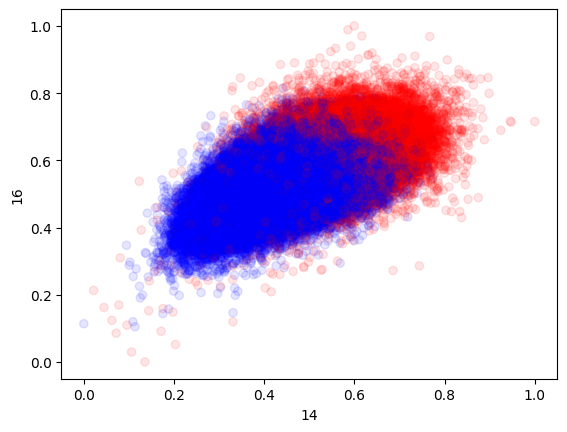

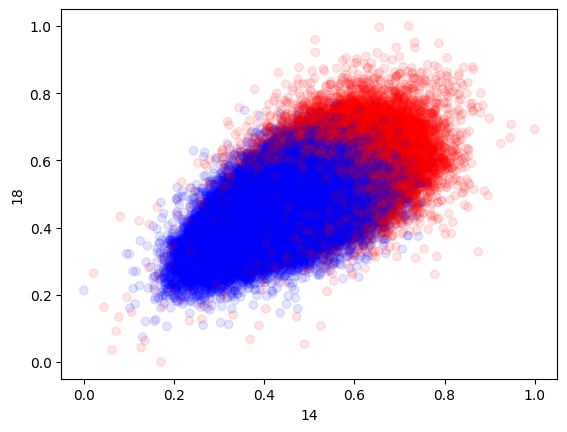

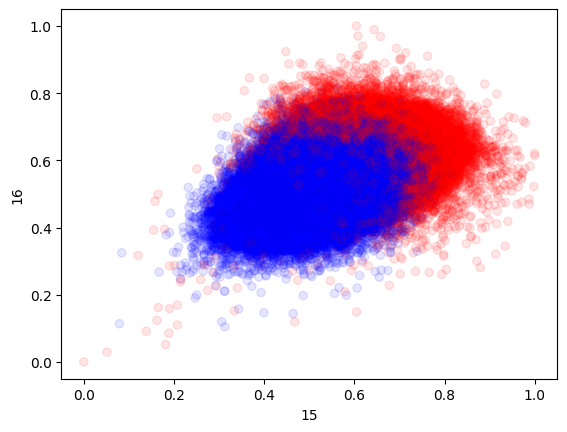

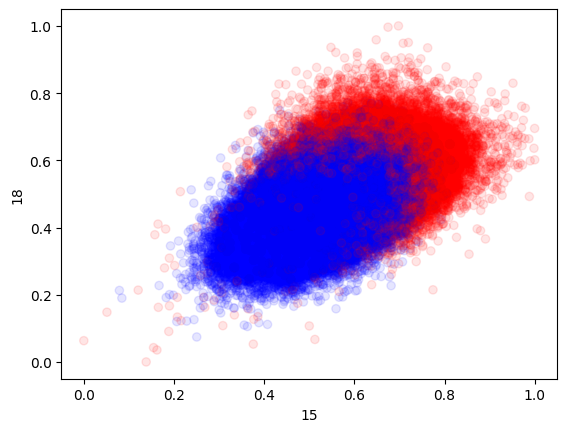

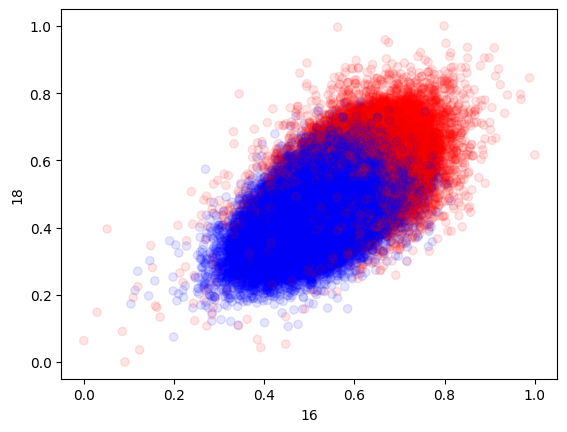

In [28]:
X_t = np.transpose(X_transformed.copy())

for i in range(len(most_affected_atts)):
    for j in range(i+1,len(most_affected_atts)):
        plot_outliers_cols(data = X_t, col1 = most_affected_atts[i], col2 = most_affected_atts[j], outliers = pred1)
del X_t

### Local outlier factor

In [29]:
lof = LocalOutlierFactor(n_neighbors=10, n_jobs=-1)
pred2 = lof.fit_predict(X_transformed)
c = (pred2<0).sum()
print("Outliers: ",c)

Outliers:  11367


In [30]:
ind = []
for i in range(len(pred2)):
    if pred2[i] == -1:
        ind.append(i)
outliers = X_transformed[ind]

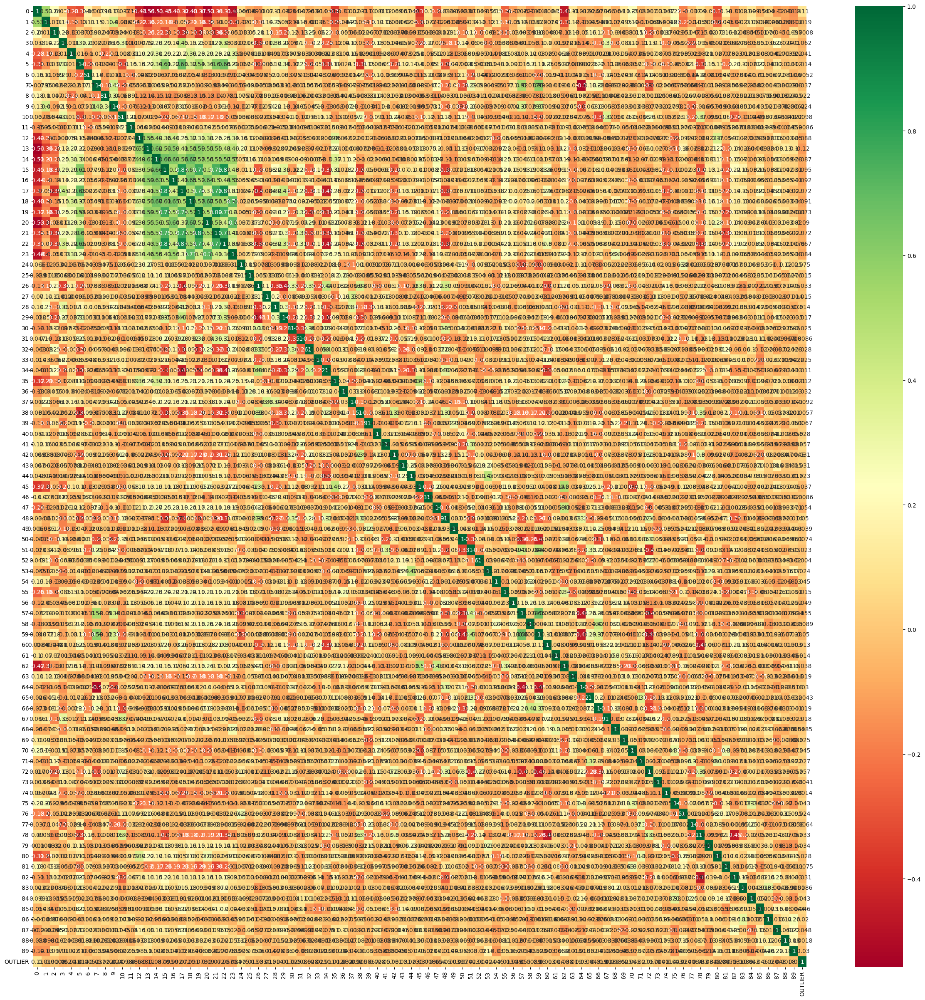

In [31]:
df = pd.DataFrame(X_transformed)
df['OUTLIER'] = pred2
plt.figure(figsize=(30,30))
g=sns.heatmap(df.corr(),annot=True,cmap="RdYlGn")

In [32]:
c = df.corr()
c = abs(c['OUTLIER']).sort_values(ascending=False).drop(['OUTLIER'])

In [33]:
most_affected_atts = list(c[:5].keys())

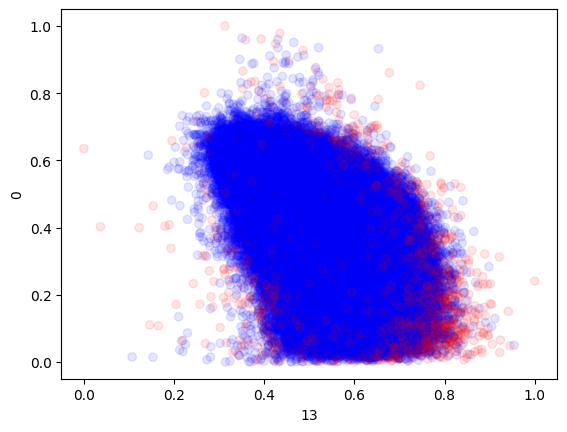

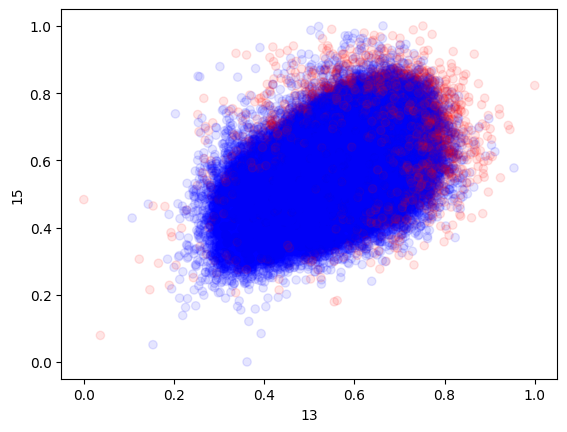

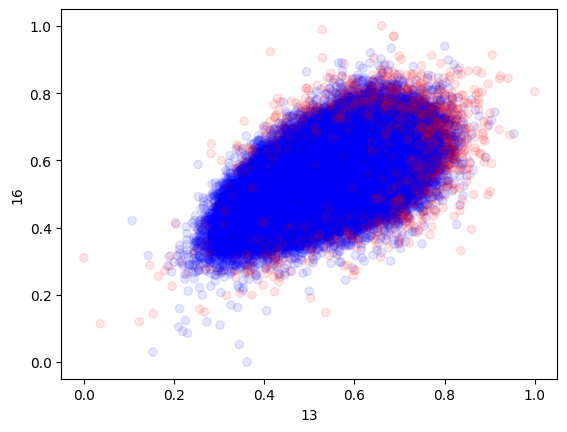

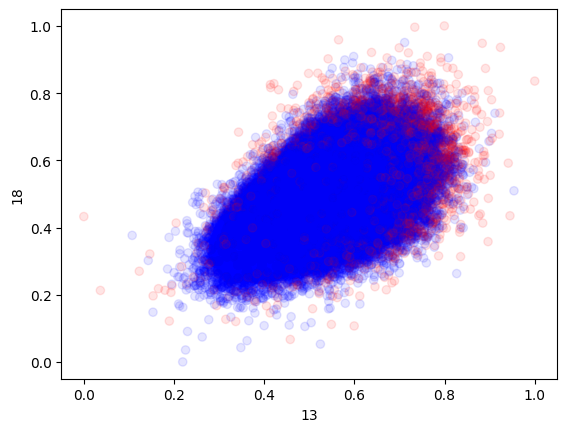

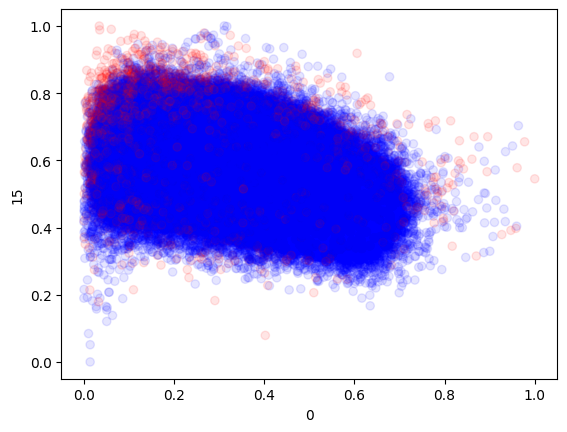

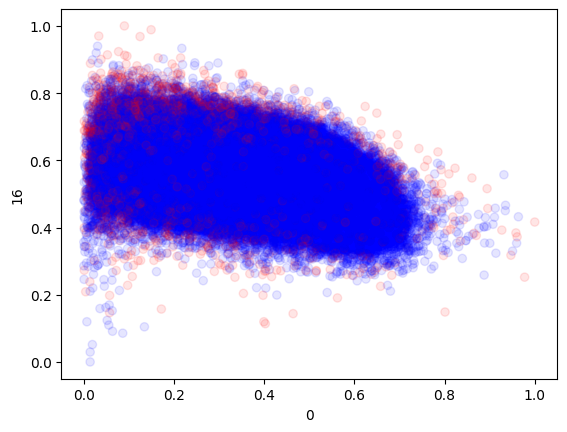

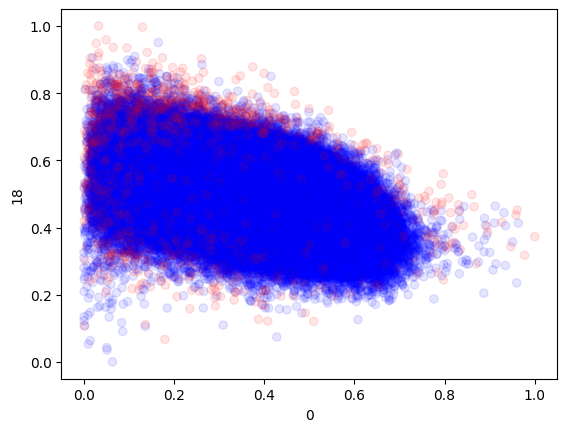

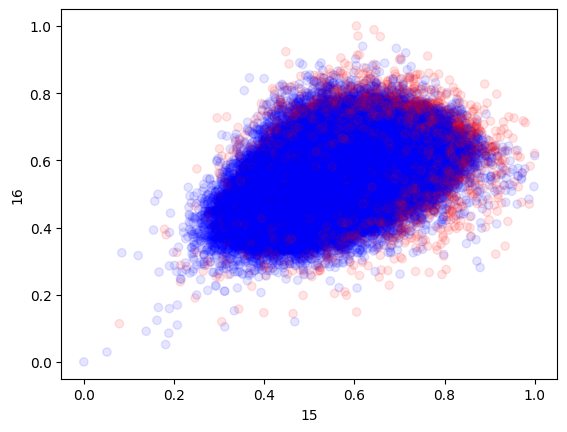

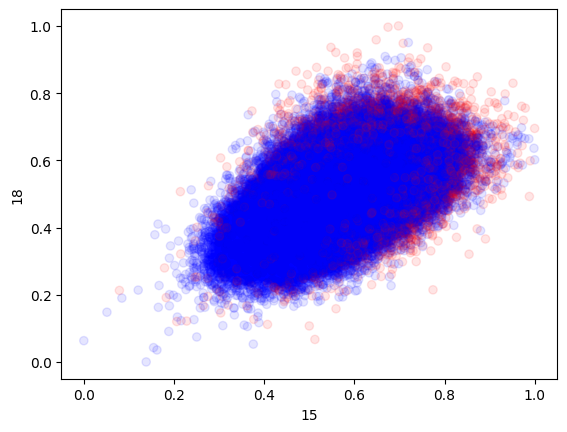

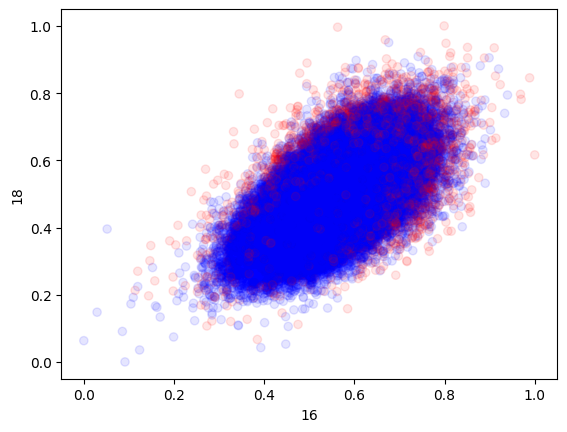

In [34]:
X_t = np.transpose(X_transformed.copy())

for i in range(len(most_affected_atts)):
    for j in range(i+1,len(most_affected_atts)):
        plot_outliers_cols(data = X_t, col1 = most_affected_atts[i], col2 = most_affected_atts[j], outliers = pred2)
del X_t

In [35]:
outlier_decades = list([y_train_decade[i] for i in ind])
uniques, counts = np.unique(outlier_decades, return_counts=True)
print(uniques)
print(counts)

[ 2  3  4  5  6  7  8  9 10 11]
[   1    2    1   35  106  223  564 2648 7568  219]


In [36]:
X_no_outliers = np.delete(X_transformed, ind, axis=0)
y_no_outliers = np.delete(y_train_decade, ind, axis=0)
y_no_outliers_full = np.delete(y_train,ind,axis=0)

In [37]:
print(len(y_no_outliers))

452348


## Oversampling & Undersampling

In [38]:
uniques, counts = np.unique(y_no_outliers, return_counts=True)
samples = 15000
sample_dict = {i: samples if j>samples else j for (i,j) in zip(uniques,counts)}
rus = RandomUnderSampler(sampling_strategy=sample_dict)
X_ou,y_ou = rus.fit_resample(X_no_outliers,y_no_outliers)

In [39]:
uniques, counts = np.unique(y_ou, return_counts=True)
samples = 5000
sample_dict = {i: samples if j<samples else j for (i,j) in zip(uniques,counts)}
sm = SMOTE(sampling_strategy=sample_dict, random_state=42)
X_ou, y_ou = sm.fit_resample(X_ou, y_ou)

In [40]:
print(uniques)
print(counts)

[ 2  3  4  5  6  7  8  9 10 11]
[  203   237   294  2792 10467 15000 15000 15000 15000  8145]


<BarContainer object of 10 artists>

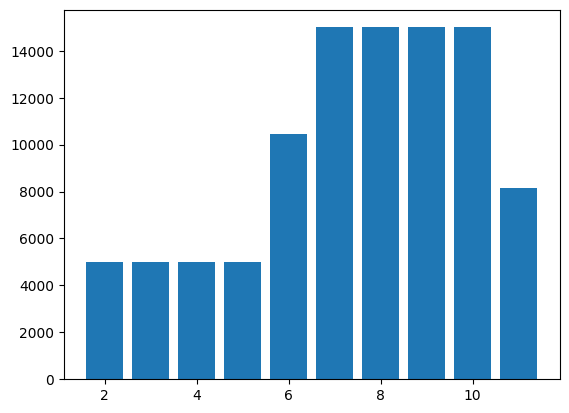

In [41]:
uniques, counts = np.unique(y_ou, return_counts=True)
plt.bar(uniques, counts, align='center')

# Dimensionality Reduction

In [42]:
def get_algorithm(alg_type, n_components, **kwargs):
    if alg_type not in ['PCA','LLE','ISO','MDS']:
        raise KeyError('The given algorithm is not supported!')
    match alg_type:
        case 'PCA': return PCA(n_components=n_components)
        case 'LLE': return LocallyLinearEmbedding(n_components=n_components, n_neighbors=kwargs['n_neighbors'], n_jobs=-1)
        case 'ISO': return Isomap(n_components=n_components, n_jobs=-1, n_neighbors=kwargs['n_neighbors'])
        case 'MDS': return MDS(n_components=n_components, n_jobs=-1, eps=kwargs['eps'])
    return None

def generate_algorithm(alg, start_components, end_components, step, **kwargs):
    i = start_components
    optional_arg = {}
    while i<=end_components:
        if len(kwargs.keys())!=0:
            b,e,s = kwargs[list(kwargs.keys())[0]]
            j = b
            while j<=e:
                optional_arg[list(kwargs.keys())[0]] = j
                dim_red = get_algorithm(alg,i,**optional_arg)
                print(dim_red)
                yield dim_red
                j+=s
        else:
            dim_red = get_algorithm(alg,i,**optional_arg)
            print(dim_red)
            yield dim_red
        i+=step

# Prediction - Decades

In [43]:
def apply_transforms_fn(X:np.array, transforms:dict, dim_red):
    X_t = np.transpose(X.copy())
    for i in range(len(X_t)):
        for t in transforms[i]:
            if t is None: continue
            X_t[i] = t.transform(X_t[i].reshape(-1,1)).reshape(1,-1)
    if dim_red is not None:
        X_t = np.transpose(dim_red.transform(np.transpose(X_t)))
    return np.transpose(X_t)

def score_predictor(X:np.array, y: np.array, predictor, transforms:dict, apply_transforms:bool = True, dim_red=None):
    X_t = np.transpose(X.copy())

    if apply_transforms and len(transforms.keys()) != len(X_t):
        raise KeyError("Number of transforms not equal to number of attributes")

    if not apply_transforms:
        ConfusionMatrixDisplay.from_estimator(predictor,X,y,normalize="pred")
        plt.show()
        return predictor.score(X, y)
    #apply all transforms first
    
    ConfusionMatrixDisplay.from_estimator(predictor,apply_transforms_fn(X,transforms,dim_red),y,normalize="all")
    plt.show()
    return predictor.score(apply_transforms_fn(X,transforms,dim_red), y)

In [44]:
sgd = SGDClassifier(n_jobs=-1)
etc = ExtraTreesClassifier(n_jobs=-1)
lda = LinearDiscriminantAnalysis()
knc = KNeighborsClassifier(n_jobs=-1)
gbc = HistGradientBoostingClassifier()
ovoSVC = SVC(decision_function_shape='ovo')
ovrSVC = SVC(decision_function_shape='ovr')
algs = [sgd,etc,lda,knc,gbc,ovoSVC,ovrSVC]

In [45]:
pca = PCA(n_components=0.97)
X_temp = pca.fit_transform(X_ou)

SGDClassifier(n_jobs=-1)


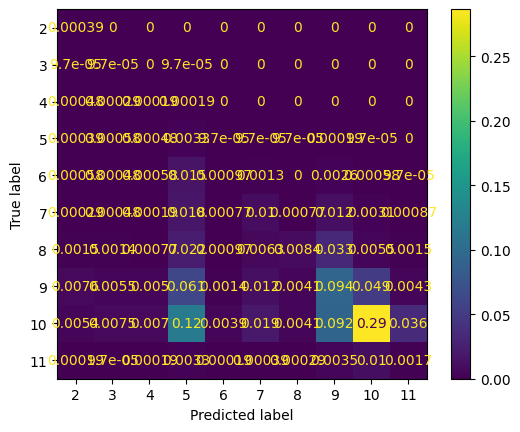

0.4053844663955065
ExtraTreesClassifier(n_jobs=-1)


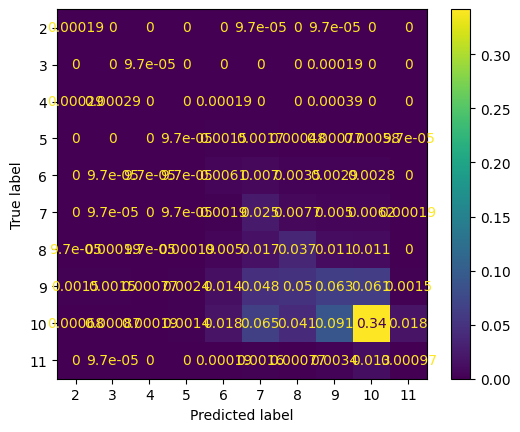

0.47385241138872747
LinearDiscriminantAnalysis()


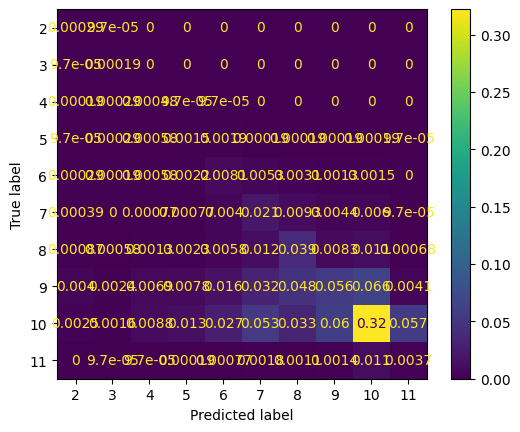

0.45196591129188457
KNeighborsClassifier(n_jobs=-1)


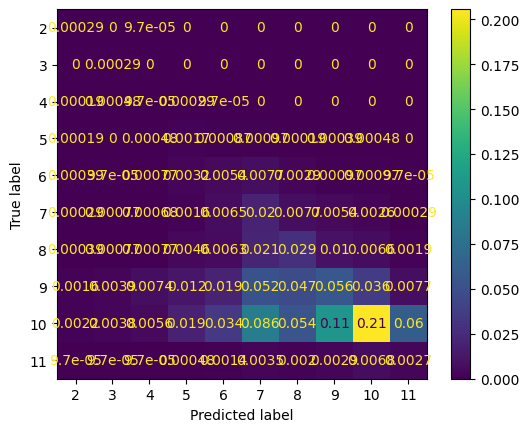

0.32151849699786944
HistGradientBoostingClassifier()


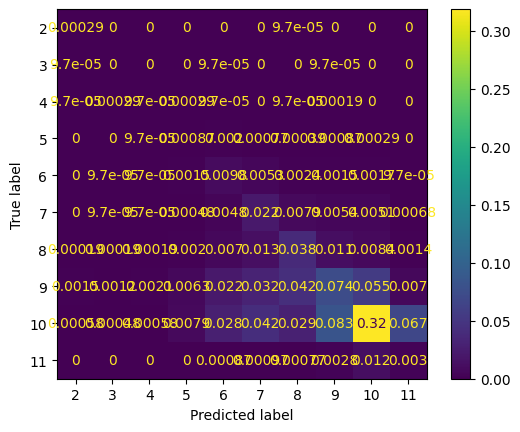

0.46658919233004065
SVC(decision_function_shape='ovo')


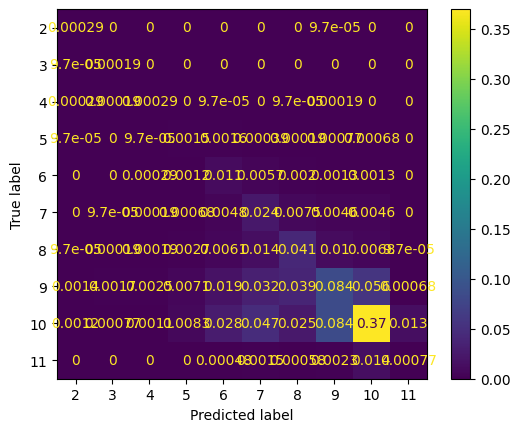

0.5322486926205694
SVC()


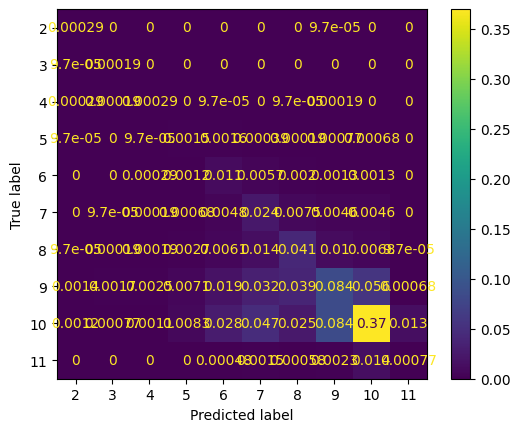

0.5322486926205694


In [46]:
for alg in algs:
    print(alg)
    alg.fit(X_temp,y_ou)
    print(score_predictor(X_valid, y_valid_decade, alg, applied_transform_dict, apply_transforms=True, dim_red=pca))
    plt.show()

## Tunes

In [47]:
sgd_tune = {'penalty':('l2','l1','elasticnet'),'alpha':(0.0001,0.001,0.01)}
etc_tune = {'max_depth':(5,7,10),'n_estimators':(500,1000,1500)}
lda_tune = {'n_components':(5,7,9)}
knc_tune = {'n_neighbors':(15,20),'p':(1,2)}
gbc_tune = {'l2_regularization':((0,0.01)),'max_depth':(5,7,9)}
svc_tune = {'kernel':('linear','poly','rbf')}
tunes = [(sgd,sgd_tune),(lda,lda_tune),(gbc,gbc_tune),(etc,etc_tune),(knc,knc_tune),(ovoSVC,svc_tune)]

Fitting 2 folds for each of 9 candidates, totalling 18 fits


SGDClassifier(alpha=0.01, n_jobs=-1)
0.37474403729858685


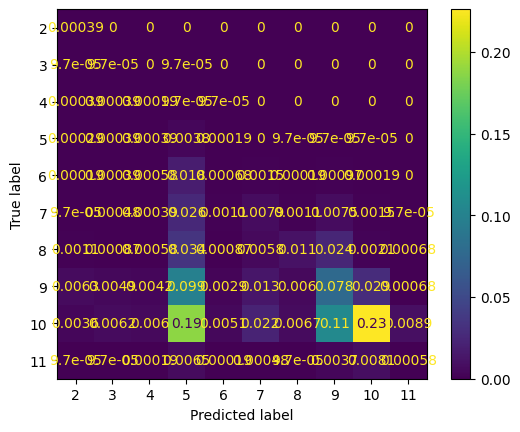

0.3285880302149913
---------------------
Fitting 2 folds for each of 3 candidates, totalling 6 fits
LinearDiscriminantAnalysis(n_components=5)
0.4352106167429424


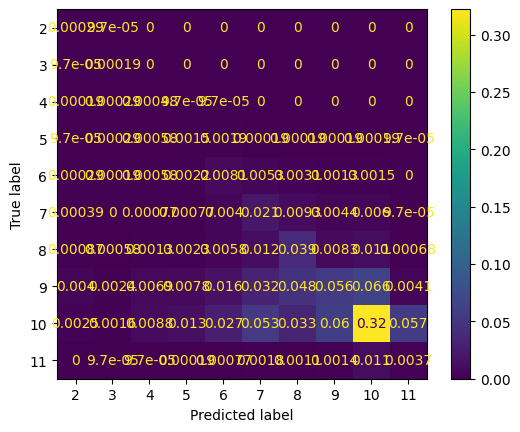

0.45196591129188457
---------------------
Fitting 2 folds for each of 6 candidates, totalling 12 fits
HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=9)
0.5881134768626677


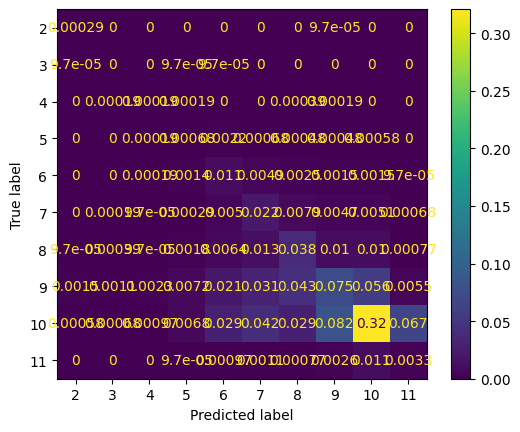

0.47143133836916523
---------------------
Fitting 2 folds for each of 9 candidates, totalling 18 fits
ExtraTreesClassifier(max_depth=10, n_estimators=1000, n_jobs=-1)
0.4258981760350783


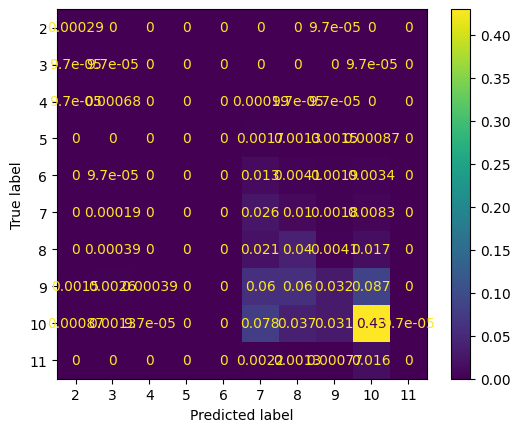

0.5272128607398799
---------------------
Fitting 2 folds for each of 4 candidates, totalling 8 fits
KNeighborsClassifier(n_jobs=-1, n_neighbors=15, p=1)
0.5540320537351557


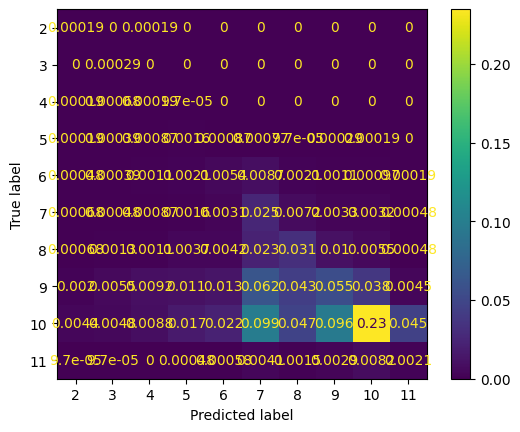

0.35725353476660854
---------------------
Fitting 2 folds for each of 3 candidates, totalling 6 fits
SVC(decision_function_shape='ovo')
0.6021212493122157


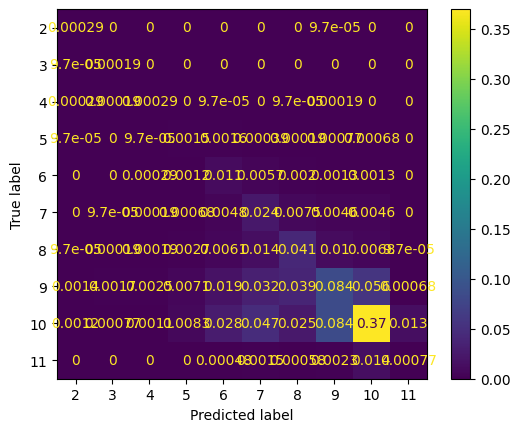

0.5322486926205694
---------------------


In [48]:
for (alg,tune) in tunes:
    grc = GridSearchCV(estimator=alg,param_grid=tune,cv=2, verbose=3, n_jobs=-1, scoring='balanced_accuracy')
    grc.fit(X_temp,y_ou)
    print(grc.best_estimator_)
    print(grc.best_score_)
    print(score_predictor(X_valid, y_valid_decade, grc.best_estimator_, applied_transform_dict, apply_transforms=True, dim_red=pca))
    print("---------------------")

In [49]:
sgd = SGDClassifier(n_jobs=-1)
etc = ExtraTreesClassifier(max_depth=10, n_estimators=1500, n_jobs=-1)
lda = LinearDiscriminantAnalysis(n_components=5)
knc = KNeighborsClassifier(n_jobs=-1, n_neighbors=15)
gbc = HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=7)
ovoSVC = SVC(decision_function_shape='ovo')
tuned_predictors = [sgd,lda,knc,gbc,etc,ovoSVC]
for i in range(len(tuned_predictors)):
    print(tuned_predictors[i])
    tuned_predictors[i].fit(X_temp,y_ou)

SGDClassifier(n_jobs=-1)


LinearDiscriminantAnalysis(n_components=5)
KNeighborsClassifier(n_jobs=-1, n_neighbors=15)
HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=7)
ExtraTreesClassifier(max_depth=10, n_estimators=1500, n_jobs=-1)
SVC(decision_function_shape='ovo')


In [50]:
rez = []
for alg in tuned_predictors:
    rez.append(alg.predict(X_temp))
    print(alg," Done")
y_predicted = np.transpose(np.stack(arrays=rez))

SGDClassifier(n_jobs=-1)  Done
LinearDiscriminantAnalysis(n_components=5)  Done
KNeighborsClassifier(n_jobs=-1, n_neighbors=15)  Done
HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=7)  Done
ExtraTreesClassifier(max_depth=10, n_estimators=1500, n_jobs=-1)  Done
SVC(decision_function_shape='ovo')  Done


In [51]:
X_valid_transforms = apply_transforms_fn(X_valid, applied_transform_dict, pca)
rez = []
for alg in tuned_predictors:
    rez.append(alg.predict(X_valid_transforms))
    print(alg," Done")
y_predicted_valid = np.stack(arrays=rez)
y_predicted_valid = np.transpose(y_predicted_valid)

SGDClassifier(n_jobs=-1)  Done
LinearDiscriminantAnalysis(n_components=5)  Done


KNeighborsClassifier(n_jobs=-1, n_neighbors=15)  Done
HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=7)  Done
ExtraTreesClassifier(max_depth=10, n_estimators=1500, n_jobs=-1)  Done
SVC(decision_function_shape='ovo')  Done


Fitting 2 folds for each of 9 candidates, totalling 18 fits


SGDClassifier(alpha=0.001, n_jobs=-1)
0.3725491211578028


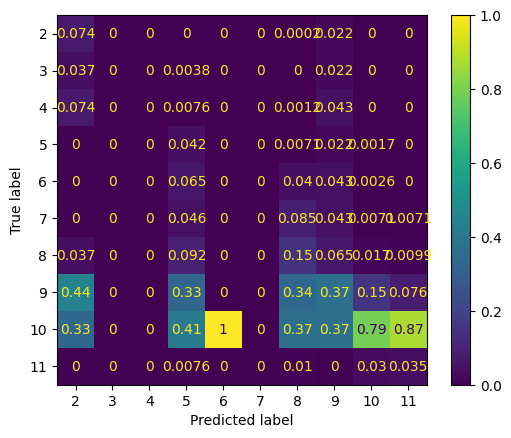

0.40141390664342436
---------------------
Fitting 2 folds for each of 3 candidates, totalling 6 fits


c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:425: FitFailedWarning: 
4 fits failed out of a total of 6.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
4 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Danilo\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Danilo\AppDa

LinearDiscriminantAnalysis(n_components=5)
0.5383256805272809


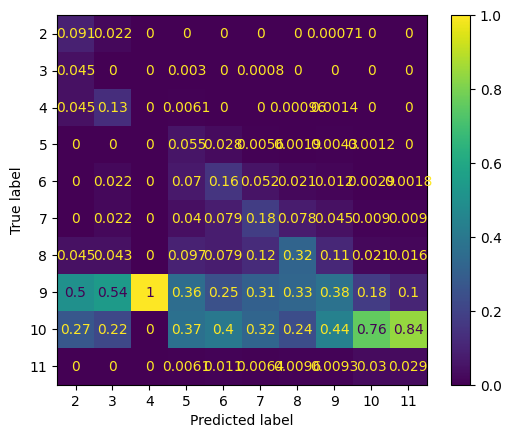

0.49331783846600813
---------------------
Fitting 2 folds for each of 6 candidates, totalling 12 fits
HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=9)
0.7377712832063241


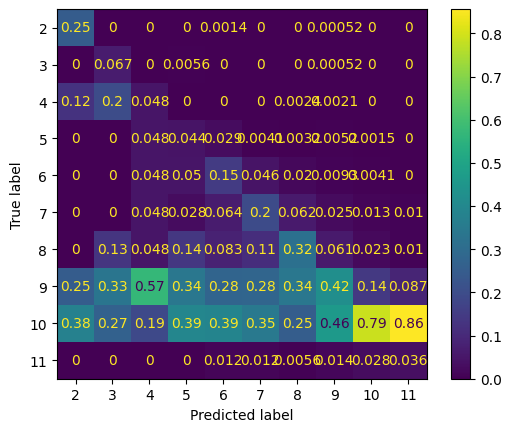

0.4514816966879721
---------------------
Fitting 2 folds for each of 9 candidates, totalling 18 fits
ExtraTreesClassifier(max_depth=10, n_estimators=1000, n_jobs=-1)
0.7292263227124312


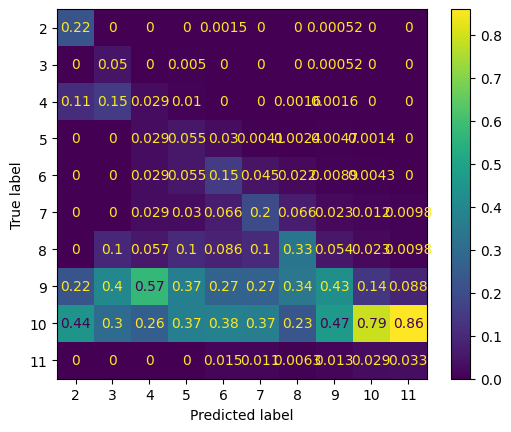

0.47656401317063724
---------------------
Fitting 2 folds for each of 4 candidates, totalling 8 fits
KNeighborsClassifier(n_jobs=-1, n_neighbors=20, p=1)
0.5647826692643345


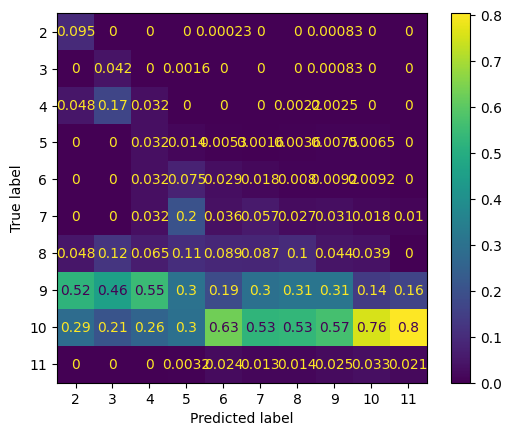

0.12928529924462523
---------------------
Fitting 2 folds for each of 3 candidates, totalling 6 fits
SVC(decision_function_shape='ovo')
0.7149084597354414


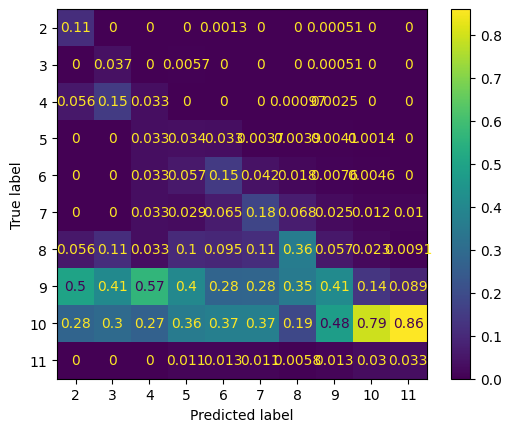

0.4732713538640325
---------------------


In [52]:
sgd_tune = {'penalty':('l2','l1','elasticnet'),'alpha':(0.0001,0.001,0.01)}
etc_tune = {'max_depth':(5,7,10),'n_estimators':(500,1000,1500)}
lda_tune = {'n_components':(5,7,9)}
knc_tune = {'n_neighbors':(15,20),'p':(1,2)}
gbc_tune = {'l2_regularization':((0,0.01)),'max_depth':(5,7,9)}
svc_tune = {'kernel':('linear','poly','rbf')}

tunes = [(SGDClassifier(n_jobs=-1),sgd_tune),\
         (LinearDiscriminantAnalysis(),lda_tune),\
         (HistGradientBoostingClassifier(),gbc_tune),\
         (ExtraTreesClassifier(n_jobs=-1),etc_tune),\
         (KNeighborsClassifier(n_jobs=-1),knc_tune),\
         (SVC(decision_function_shape='ovo'),svc_tune)]
for (alg,tune) in tunes:
    grc = GridSearchCV(estimator=alg,param_grid=tune,cv=2, verbose=3, n_jobs=-1, scoring='balanced_accuracy')
    grc.fit(y_predicted,y_ou)
    print(grc.best_estimator_)
    print(grc.best_score_)
    print(score_predictor(y_predicted_valid, y_valid_decade, grc.best_estimator_, applied_transform_dict, apply_transforms=False, dim_red=None))
    print("---------------------")

# Test

In [53]:
def apply_transforms_fn(X:np.array, transforms:dict, dim_red):
    X_t = np.transpose(X.copy())
    for i in range(len(X_t)):
        for t in transforms[i]:
            if t is None: continue
            X_t[i] = t.transform(X_t[i].reshape(-1,1)).reshape(1,-1)
    if dim_red is not None:
        X_t = np.transpose(dim_red.transform(np.transpose(X_t)))
    return np.transpose(X_t)

def score_predictor(X:np.array, y: np.array, predictor, transforms:dict, apply_transforms:bool = True, dim_red=None):
    X_t = np.transpose(X.copy())

    if apply_transforms and len(transforms.keys()) != len(X_t):
        raise KeyError("Number of transforms not equal to number of attributes")

    if not apply_transforms:
        ConfusionMatrixDisplay.from_estimator(predictor,apply_transforms_fn(X,transforms,dim_red),y,normalize="all")
        plt.show()
        return predictor.score(X, y)
    #apply all transforms first
    
    ConfusionMatrixDisplay.from_estimator(predictor,apply_transforms_fn(X,transforms,dim_red),y,normalize="all")
    plt.show()
    return predictor.score(apply_transforms_fn(X,transforms,dim_red), y)

## Prvi testovi

<div class="alert alert-block alert-success">
<b>Testiranjem sa KNeighborsClassifier</b>: 
    </br>
    - Preciznost sa n_neighbors = 15 bez normalizacije i skaliranja atributa : 0.567499515785396
    </br>
    - Preciznost sa n_neighbors = 15 sa normalizacijom i skaliranjem atributa : 0.6094325004842146
</div>

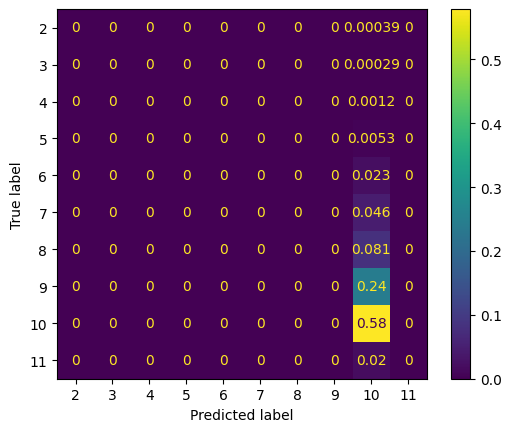

0.567499515785396


In [54]:
kn = KNeighborsClassifier(n_neighbors=15)
kn.fit(X_train,y_train_decade)
print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=False))

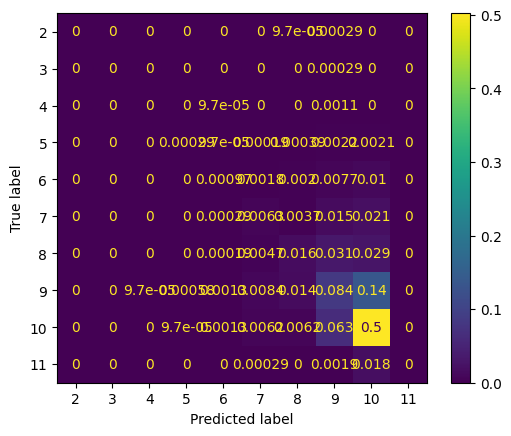

0.6094325004842146


In [55]:
kn = KNeighborsClassifier(n_neighbors=15)
kn.fit(X_transformed,y_train_decade)
print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True))

<div class="alert alert-block alert-success">
<b>Testiranjem sa KNeighborsClassifier nakon izbacivanja outliera (LOF)</b>: 
    </br>
    - Preciznost sa n_neighbors = 15 sa normalizacijom i skaliranjem atributa : 0.6095293434049971
</div>

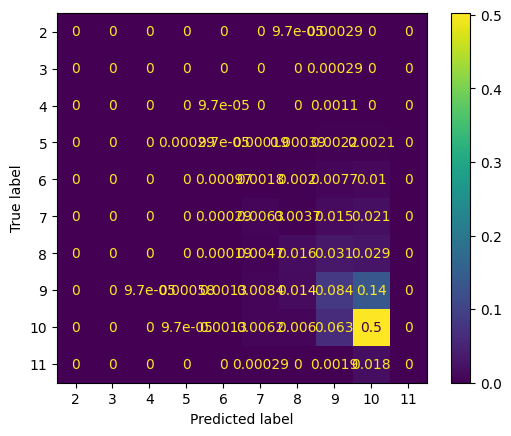

0.6095293434049971


In [56]:
kn = KNeighborsClassifier(n_neighbors=15)
kn.fit(X_no_outliers,y_no_outliers)
print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True))

<div class="alert alert-block alert-success">
<b>Rezultati sa oversamplovanjem i undersamplovanjem</b>: </br>
<ul>
    <li> SMOTE: 0.6089482858803021 </li>
    <li> ADASYN: 0.6092388146426496 </li>
</ul>
</div>

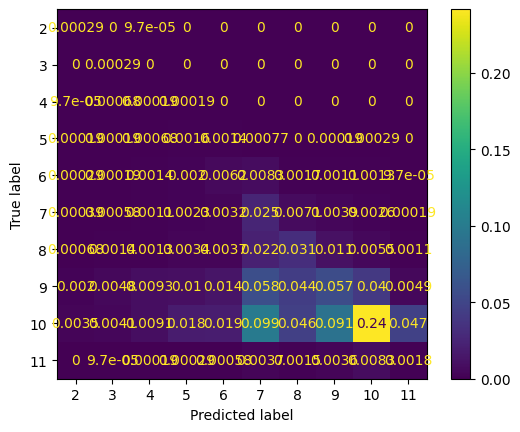

0.3650978113499903


In [57]:
kn = KNeighborsClassifier(n_neighbors=15)
kn.fit(X_ou,y_ou)
print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True))

<div class="alert alert-block alert-success">
<b>Testiranje n_neighbors za Local Outlier Factor</b>: 
<ul>
    <li>5: 0.6092388146426496</li>
    <li>10: 0.6095293434049971</li>
    <li>20: 0.6095293434049971</li>
    <li>30: 0.6092388146426496</li>
    <li>40: 0.6093356575634321</li>
    <li>50: 0.6093356575634321</li>
</ul>
</div>
Minimalne razlike, najbolji rezultati za n_neighbors = 10

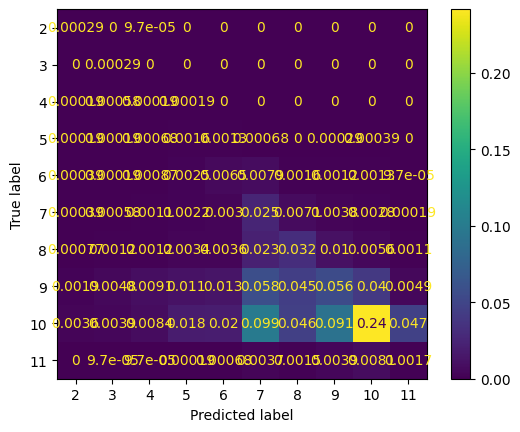

0.36480728258764283


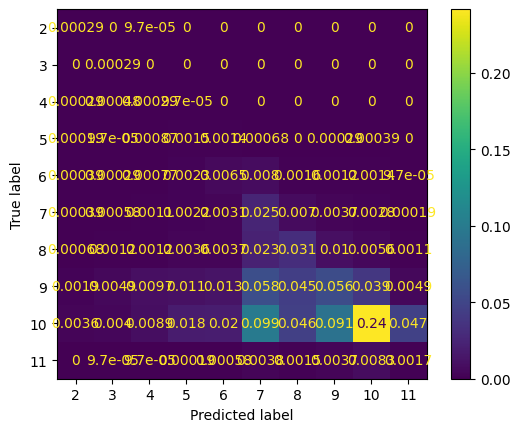

0.3651946542707728


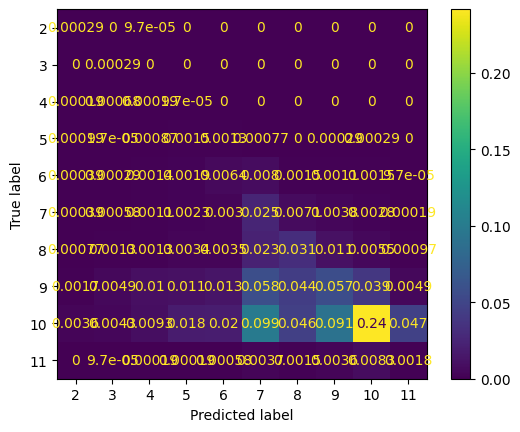

0.3653883401123378


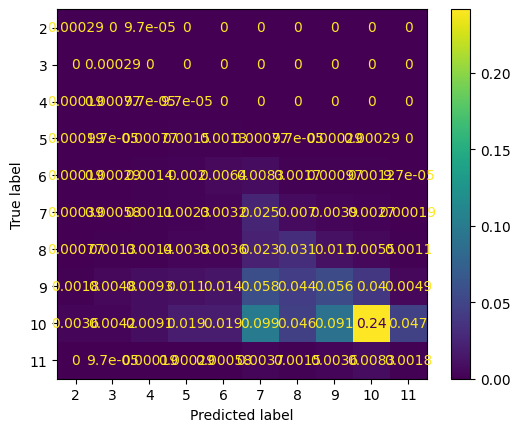

0.3650978113499903


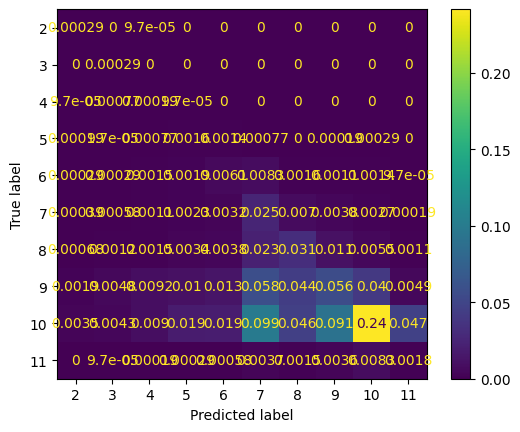

0.36480728258764283


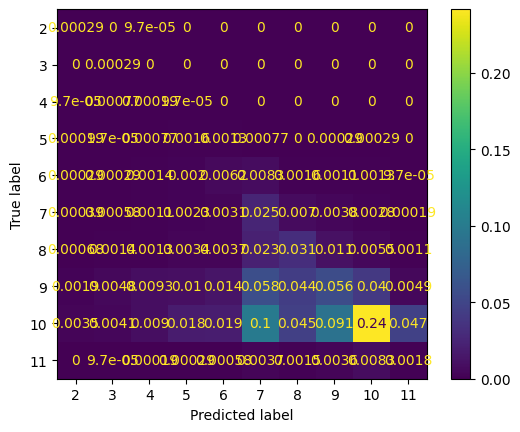

0.3650009684292078


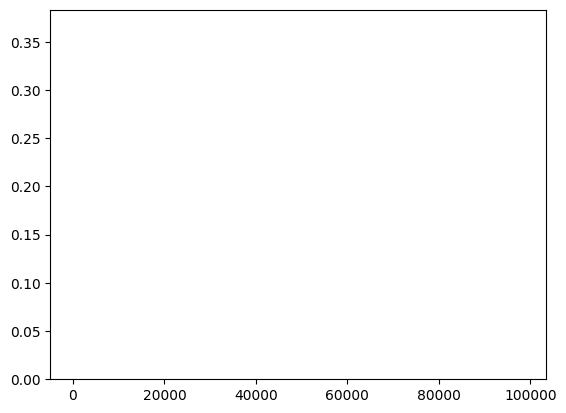

In [58]:
def test_lof(n_neighbor_vals, predictor, X, y, X_test, y_test, transforms):
    rez = {i:0 for i in n_neighbor_vals}
    for i in n_neighbor_vals:
        lof = LocalOutlierFactor(n_neighbors=i, n_jobs=-1)
        pred2 = lof.fit_predict(X)
        ind = []
        for i in range(len(pred2)):
            if pred2[i] == -1:
                ind.append(i)
        X_local = np.delete(X, ind, axis=0)
        y_local = np.delete(y, ind, axis=0)

        predictor.fit(X_local,y_local)
        score = score_predictor(X_test, y_test, predictor=predictor, transforms=transforms, apply_transforms=True)
        rez[i] = score
        print(score)
    plt.bar(list(rez.keys()),list(rez.values()))
    plt.show()
kn = KNeighborsClassifier(n_neighbors=15)
test_lof([5,10,20,30,40,50],kn,X_ou,y_ou, X_valid, y_valid_decade, applied_transform_dict)

<div class="alert alert-block alert-success">
<b>Testiranje redukcije dimenzionalnost</b>: 
<ul>
    <li>PCA smanjuje malo preciznost - na oko 0.6081 za n_components=0.98</li>
    <li>Nelinearna redukcija dimenzionalnosti ima gore performanse od PCA</li>
    <li>Promenom n_neighbors i n_clusters nema velike promene</li>
    <li>Najveca promena je sa povecanjem broja instanci za trening nelinearnih algoritama</li>
    <li>ISOMap i MDS nemaju dovoljno memorije za treniranje</li>
</ul>
</div>

PCA(n_components=0.95)


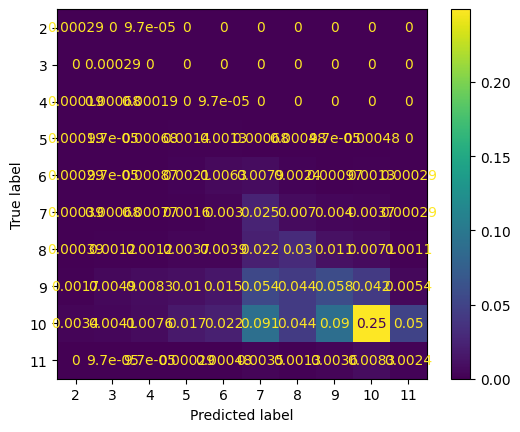

0.37352314545806703
PCA(n_components=0.96)


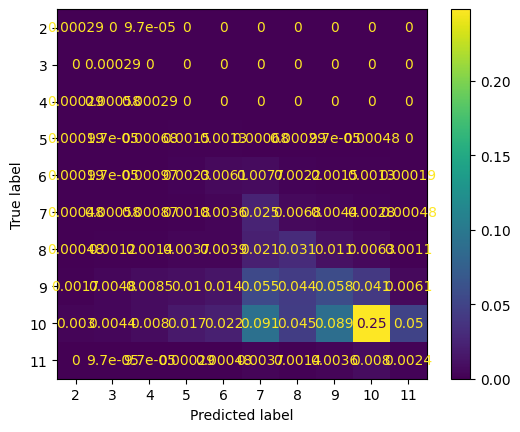

0.37197365872554716
PCA(n_components=0.97)


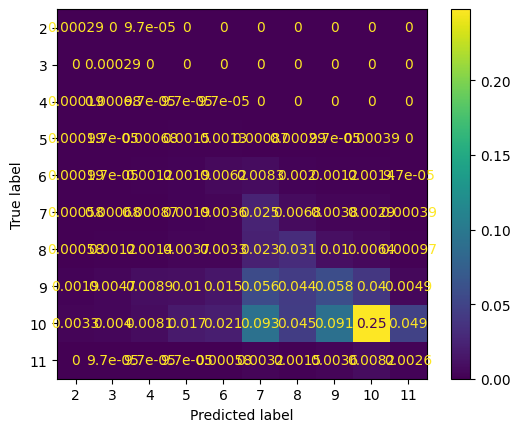

0.3729420879333721
PCA(n_components=0.98)


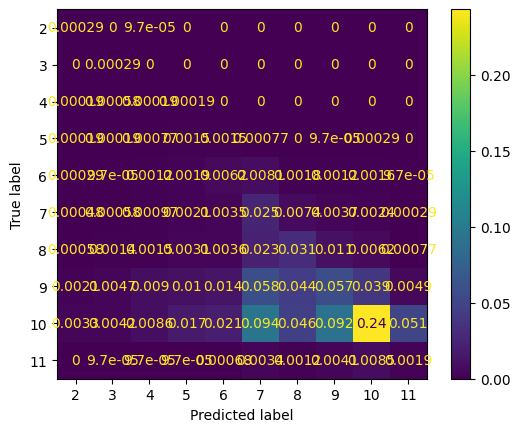

0.36684098392407516
PCA(n_components=0.99)


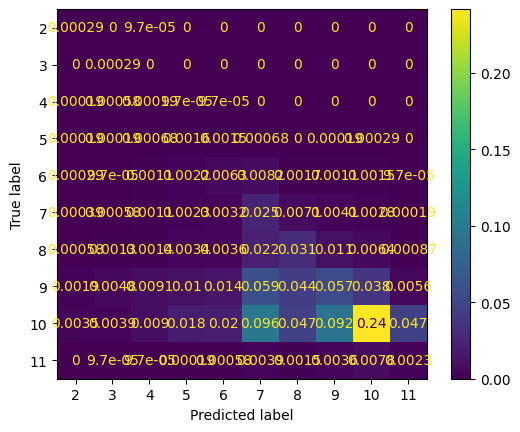

0.36471043966686034


In [59]:
gen = generate_algorithm('PCA', 0.95, 0.99, 0.01)
for dim in gen:
    kn = KNeighborsClassifier(n_neighbors=15)
    x = dim.fit_transform(X_ou)
    kn.fit(x,y_ou)
    print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True, dim_red=dim))
del gen

LocallyLinearEmbedding(n_components=3, n_jobs=-1, n_neighbors=15)


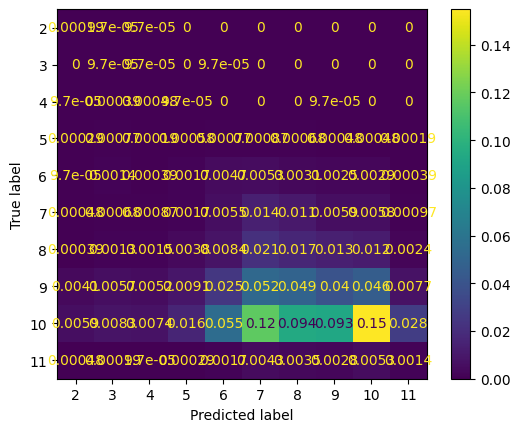

0.2326166957195429
-----------------------------------------
LocallyLinearEmbedding(n_components=10, n_jobs=-1, n_neighbors=15)


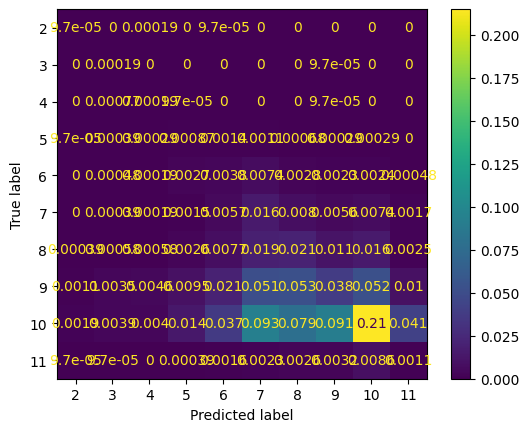

0.29604880883207435
-----------------------------------------
LocallyLinearEmbedding(n_components=17, n_jobs=-1, n_neighbors=15)


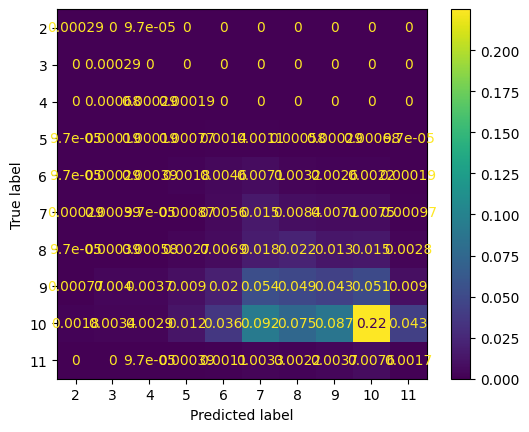

0.3139647491768352
-----------------------------------------
LocallyLinearEmbedding(n_components=24, n_jobs=-1, n_neighbors=15)


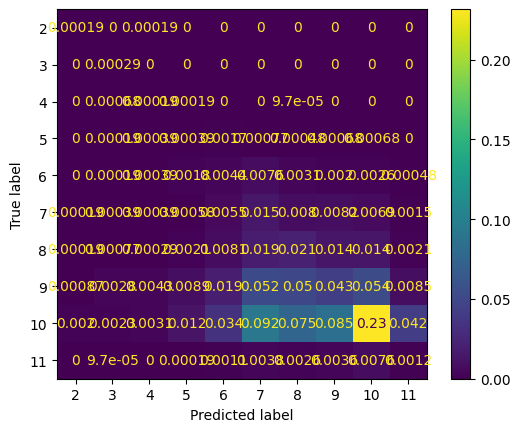

0.3168700368003099
-----------------------------------------


In [60]:
gen = generate_algorithm('LLE', 3, 24, 7, n_neighbors=(15,20,15))
fit_samples = 15000
indices = [random.randint(0,len(X_ou)-1) for _ in range(fit_samples)]
for dim in gen:
    kn = KNeighborsClassifier(n_neighbors=15)
    dim.fit(X_ou[indices])
    x = dim.transform(X_ou)
    kn.fit(x,y_ou)
    print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True,dim_red=dim))
    print("-----------------------------------------")
del gen

LocallyLinearEmbedding(n_components=40, n_jobs=-1, n_neighbors=15)


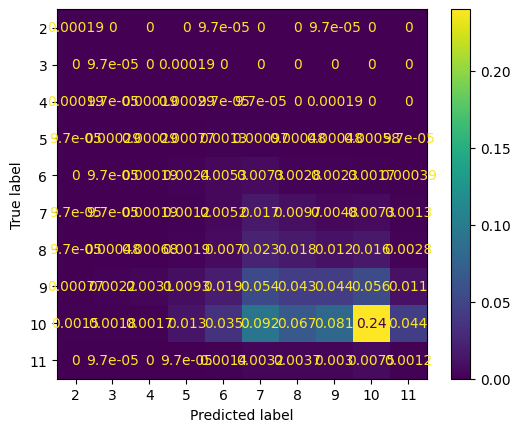

0.32587642843308157
-----------------------------------------
LocallyLinearEmbedding(n_components=50, n_jobs=-1, n_neighbors=15)


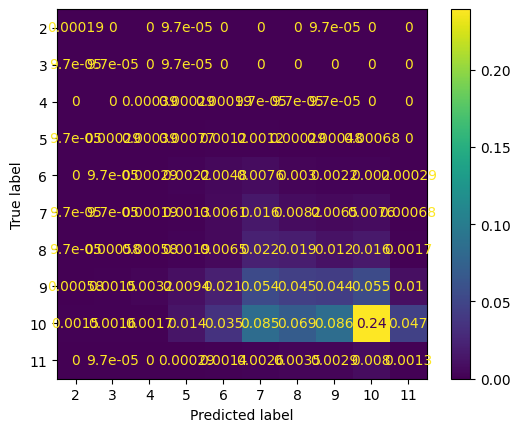

0.3257795855122991
-----------------------------------------


In [61]:
gen = generate_algorithm('LLE', 40, 50, 10, n_neighbors=(15,20,15))
fit_samples = 20000
indices = [random.randint(0,len(X_ou)-1) for _ in range(fit_samples)]
for dim in gen:
    kn = KNeighborsClassifier(n_neighbors=15)
    dim.fit(X_ou[indices])
    x = dim.transform(X_ou)
    kn.fit(x,y_ou)
    print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True,dim_red=dim))
    print("-----------------------------------------")
del gen

Isomap(n_components=3, n_jobs=-1, n_neighbors=25)


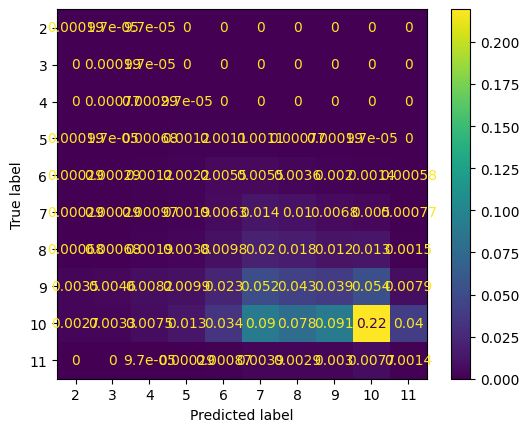

0.2987604106139841
-----------------------------------------
Isomap(n_components=30, n_jobs=-1, n_neighbors=25)


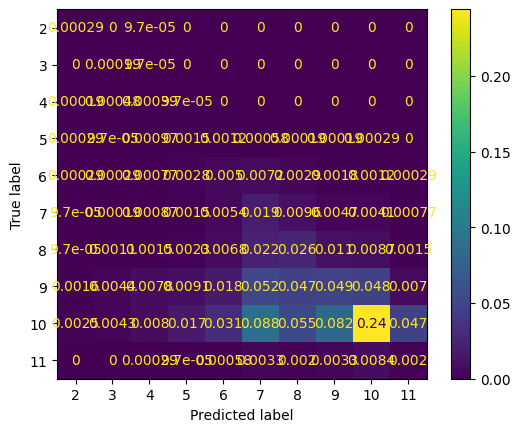

0.3485376718961844
-----------------------------------------


In [62]:
gen = generate_algorithm('ISO', 3, 30, 27, n_neighbors=(25,30,15))
fit_samples = 15000
indices = [random.randint(0,len(X_ou)-1) for _ in range(fit_samples)]
for dim in gen:
    kn = KNeighborsClassifier(n_neighbors=15)
    dim.fit(X_ou[indices])
    x = dim.transform(X_ou)
    kn.fit(x,y_ou)
    print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True,dim_red=dim))
    print("-----------------------------------------")
del gen

Isomap(n_components=40, n_jobs=-1, n_neighbors=25)


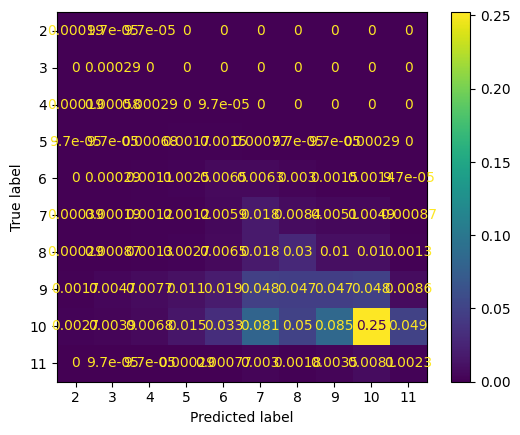

0.35831880689521595
-----------------------------------------
Isomap(n_components=50, n_jobs=-1, n_neighbors=25)


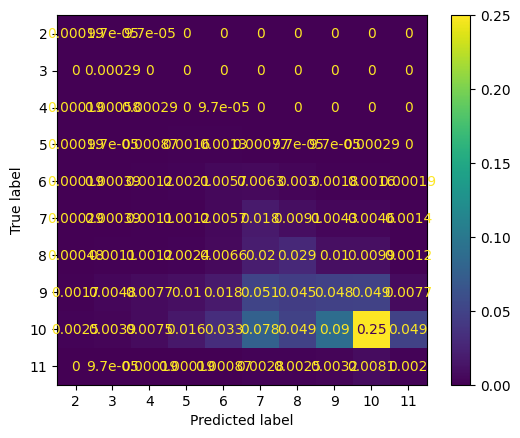

0.35531667635095876
-----------------------------------------


In [63]:
gen = generate_algorithm('ISO', 40, 50, 10, n_neighbors=(25,25,10))
fit_samples = 15000
indices = [random.randint(0,len(X_ou)-1) for _ in range(fit_samples)]
for dim in gen:
    kn = KNeighborsClassifier(n_neighbors=15)
    dim.fit(X_ou[indices])
    x = dim.transform(X_ou)
    kn.fit(x,y_ou)
    print(score_predictor(X_valid, y_valid_decade, kn, applied_transform_dict, apply_transforms=True,dim_red=dim))
    print("-----------------------------------------")
del gen

# TODO

- Finalne predikcije, testovi

**Zapazanja**
- 20: SGD najbolji - 100%, LDA, KNC, SVC su solidni -75%, ETC 50%
- 30: KNC, LDA, SVC - najbolji (100% i 67%)
- 40: LDA je najbolji - 42%, posle toga KNC i SVC
- 50: LDA - 31%, KNC 33%
- 60: ETC, LDA ~ 30%, HGBC, SVC - 47%
- 70: ETC, SVC - 52%, HGBC - 47%
- 80: ETC - 43%, LDA,HGBC 48%, SVC 50%
- 90: SGD - 92%, HGBC, SVC - 35%
- 00: ETC, LDA, HGBC, SVC ~ 60%
- 10: LDA, KNC, HGBC ~15-20%

Kada kolektivno glasaju + SGD - 80% 6